In [1]:
from sqlite3 import SQLITE_CREATE_VIEW
import anndata
import scanpy as sc
import os
from bbknn import bbknn
import matplotlib.pyplot as plt
import omicverse as ov
import scvi
import scib
from scvi.model.utils import mde
from scib_metrics.benchmark import Benchmarker
import scanorama
import numpy as np
import pyliger
from harmony import harmonize
from rich import print
import seaborn as sns
import bbknn
import doubletdetection
%matplotlib inline
plt.rcParams.update({'font.size': 12})


   ____            _     _    __                  
  / __ \____ ___  (_)___| |  / /__  _____________ 
 / / / / __ `__ \/ / ___/ | / / _ \/ ___/ ___/ _ \ 
/ /_/ / / / / / / / /__ | |/ /  __/ /  (__  )  __/ 
\____/_/ /_/ /_/_/\___/ |___/\___/_/  /____/\___/                                              

Version: 1.5.3, Tutorials: https://omicverse.readthedocs.io/


Global seed set to 0
/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/umap/plot.py:203: NumbaDeprecationWarning: The keyword argument 'nopython=False' was supplied. From Numba 0.59.0 the default is being changed to True and use of 'nopython=False' will raise a warning as the argument will have no effect. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.


In [2]:
# R interface
from rpy2.robjects import pandas2ri
from rpy2.robjects import r
import rpy2.rinterface_lib.callbacks
import anndata2ri

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

In [3]:
%%R
# R packages
library(Seurat)


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

Loading required package: SeuratObject
Loading required package: sp

Attaching package: ‘SeuratObject’

The following object is masked from ‘package:base’:

    intersect

In addition: Warning message:
In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages


In [4]:
#####Change path and Load data
os.chdir("/mnt/disk5/Lanxiang/Human_integrated/integrated/8_Progress/human_ref_all")
adata = anndata.read_h5ad("human_ref.h5ad")

/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/anndata/_io/utils.py:202: OldFormatWarning: Element '/obs/orig.ident' was written without encoding metadata.
/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/anndata/_io/utils.py:202: OldFormatWarning: Element '/obs/nCount_RNA' was written without encoding metadata.
/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/anndata/_io/utils.py:202: OldFormatWarning: Element '/obs/nFeature_RNA' was written without encoding metadata.
/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/anndata/_io/utils.py:202: OldFormatWarning: Element '/obs/sample' was written without encoding metadata.
/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/anndata/_io/utils.py:202: OldFormatWarning: Element '/obs/stage' was written without encoding metadata.
/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/anndata/_io/utils.py:202: OldFormatWarning: Element '/obs/percent.mt' was written without 

In [5]:
adata

AnnData object with n_obs × n_vars = 34387 × 75865
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno'
    var: 'features'

In [6]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample,stage,percent.mt,species,embryo,platform,anno,sub_anno,harmo.anno
AAACCTGAGACGCTTT-1_1_1_1_1_1_1,mole,112028.0,9381,Sample1,E9_IVC,5.228157,Homo sapiens,Real Embryo in vitro,10x-Genomics,TE_CTB_STB,TE_CTB_STB,TE/TrB
AACGTTGAGACGCAAC-1_1_1_1_1_1_1,mole,191885.0,8618,Sample1,E9_IVC,14.688485,Homo sapiens,Real Embryo in vitro,10x-Genomics,TE_CTB_STB,TE_CTB_STB,TE/TrB
AACTCAGCAGACGCCT-1_1_1_1_1_1_1,mole,189565.0,7942,Sample1,E9_IVC,7.517738,Homo sapiens,Real Embryo in vitro,10x-Genomics,TE_CTB_STB,TE_CTB_STB,TE/TrB
AAGACCTTCGGCGCTA-1_1_1_1_1_1_1,mole,25545.0,4869,Sample1,E9_IVC,17.987865,Homo sapiens,Real Embryo in vitro,10x-Genomics,TE_CTB_STB,TE_CTB_STB,TE/TrB
AAGCCGCCATATGGTC-1_1_1_1_1_1_1,mole,107601.0,10074,Sample1,E9_IVC,3.851265,Homo sapiens,Real Embryo in vitro,10x-Genomics,Hypoblast,Hypoblast,Hypoblast
...,...,...,...,...,...,...,...,...,...,...,...,...
GAATCTGA,zhou,7297.0,2026,tri-vol-d8-181015T,E8_IVC,12.210497,Homo sapiens,Tri_hv_D8_IVC2_E7_B3_46,STRT-Seq,TE,TE,TE/TrB
GCCAAGAC,zhou,7962.0,2019,tri-vol-d8-181015T,E8_IVC,0.879176,Homo sapiens,Tri_hv_D8_IVC2_E7_B3_96,STRT-Seq,TE,TE,TE/TrB
GTCGTAGA,zhou,9702.0,2740,tri-vol-d8-181015T,E8_IVC,4.648526,Homo sapiens,Tri_hv_D8_IVC2_E7_B3_57,STRT-Seq,PE,PE,Hypoblast
TATCAGCA,zhou,10857.0,2771,tri-vol-d8-181015T,E8_IVC,3.232937,Homo sapiens,Tri_hv_D8_IVC2_E7_B3_61,STRT-Seq,TE,TE,TE/TrB


In [7]:
set(adata.obs["harmo.anno"])

{'Endoderm',
 'Epiblast',
 'ExE.Endoderm',
 'ExE.Mesoderm',
 'Hemogenic.Endothelial.Progenitors',
 'Hypoblast',
 'ICM',
 'Mesoderm',
 'Neural.Ectoderm',
 'Non-Neural.Ectoderm',
 'Notochord',
 'PGC',
 'Primitive.streak',
 'TE/TrB',
 'Unknown'}

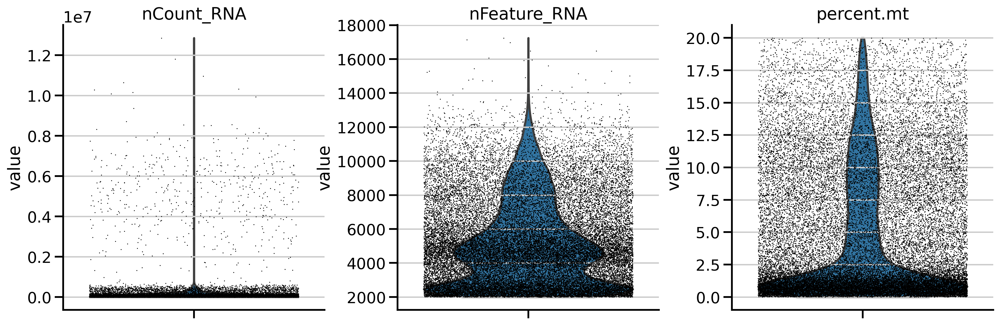

In [8]:
sc.pl.violin(
    adata,
    ["nCount_RNA", "nFeature_RNA", "percent.mt"],
    jitter=0.4,
    multi_panel=True,
    save= "violin_plot.pdf"
)

In [9]:
##filter nFeature_RNA and percent.mt
#adata = adata[adata.obs.nFeature_RNA > 2000, :]
#adata = adata[adata.obs["percent.mt"] < 20, :]

In [10]:
# remove "empty" genes
sc.pp.filter_genes(adata, min_cells=1)

In [11]:
adata

AnnData object with n_obs × n_vars = 34387 × 60421
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno'
    var: 'features', 'n_cells'

In [12]:
clf = doubletdetection.BoostClassifier(
    n_iters=40,
    clustering_algorithm="louvain",
    standard_scaling=True,
    pseudocount=0.1,
    n_jobs=-1,
)
doublets = clf.fit(adata.X).predict(p_thresh=1e-16, voter_thresh=0.5)
doublet_score = clf.doublet_score()

  0%|          | 0/40 [00:00<?, ?it/s]

In [13]:
adata.obs["doublet"] = doublets
adata.obs["doublet_score"] = doublet_score

In [14]:
adata

AnnData object with n_obs × n_vars = 34387 × 60421
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score'
    var: 'features', 'n_cells'

In [15]:
print(adata.X)

(0, 4)        1.0
  (0, 10)       1.0
  (0, 12)       2.0
  (0, 20)       9.0
  (0, 22)       1.0
  (0, 25)       5.0
  (0, 26)       9.0
  (0, 28)       2.0
  (0, 31)       4.0
  (0, 39)       9.0
  (0, 40)       2.0
  (0, 43)       14.0
  (0, 46)       2.0
  (0, 47)       6.0
  (0, 48)       6.0
  (0, 53)       1.0
  (0, 54)       55.0
  (0, 55)       3.0
  (0, 56)       2.0
  (0, 57)       34.0
  (0, 63)       8.0
  (0, 65)       9.0
  (0, 66)       4.0
  (0, 68)       34.0
  (0, 75)       5.0
  :     :
  (34386, 54555)        2.0
  (34386, 54602)        2.0
  (34386, 54741)        3.0
  (34386, 54995)        1.0
  (34386, 55690)        1.0
  (34386, 55793)        1.0
  (34386, 55885)        1.0
  (34386, 56090)        39.0
  (34386, 56246)        1.0
  (34386, 56289)        1.0
  (34386, 56587)        1.0
  (34386, 56664)        2.0
  (34386, 56864)        1.0
  (34386, 56957)        1.0
  (34386, 57063)        4.0
  (34386, 57510)        2.0
  (34386, 57591)        1.0
  (34386, 57708)        3.0
  (34386, 57788)        1.0
  (34386, 57953)        1.0
  (34386, 57958)        1.0
  (34386, 58802)        1.0
  (34386, 58833)        1.0
  (34386, 60398)        49.0
  (34386, 60400)        104.0

In [16]:
adata.layers["counts"] = adata.X.copy()

In [17]:
sc.settings.seed = 42
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers["logcounts"] = adata.X.copy()
sc.pp.highly_variable_genes(adata, n_top_genes=2000, flavor="cell_ranger", batch_key="orig.ident")
sc.tl.pca(adata, n_comps=30, use_highly_variable=True)

In [18]:
adata

AnnData object with n_obs × n_vars = 34387 × 60421
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [19]:
print(adata.layers["counts"])

(0, 4)        1.0
  (0, 10)       1.0
  (0, 12)       2.0
  (0, 20)       9.0
  (0, 22)       1.0
  (0, 25)       5.0
  (0, 26)       9.0
  (0, 28)       2.0
  (0, 31)       4.0
  (0, 39)       9.0
  (0, 40)       2.0
  (0, 43)       14.0
  (0, 46)       2.0
  (0, 47)       6.0
  (0, 48)       6.0
  (0, 53)       1.0
  (0, 54)       55.0
  (0, 55)       3.0
  (0, 56)       2.0
  (0, 57)       34.0
  (0, 63)       8.0
  (0, 65)       9.0
  (0, 66)       4.0
  (0, 68)       34.0
  (0, 75)       5.0
  :     :
  (34386, 54555)        2.0
  (34386, 54602)        2.0
  (34386, 54741)        3.0
  (34386, 54995)        1.0
  (34386, 55690)        1.0
  (34386, 55793)        1.0
  (34386, 55885)        1.0
  (34386, 56090)        39.0
  (34386, 56246)        1.0
  (34386, 56289)        1.0
  (34386, 56587)        1.0
  (34386, 56664)        2.0
  (34386, 56864)        1.0
  (34386, 56957)        1.0
  (34386, 57063)        4.0
  (34386, 57510)        2.0
  (34386, 57591)        1.0
  (34386, 57708)        3.0
  (34386, 57788)        1.0
  (34386, 57953)        1.0
  (34386, 57958)        1.0
  (34386, 58802)        1.0
  (34386, 58833)        1.0
  (34386, 60398)        49.0
  (34386, 60400)        104.0

In [20]:
adata_hvg = adata[:, adata.var.highly_variable].copy()

In [21]:
adata_hvg

AnnData object with n_obs × n_vars = 34387 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

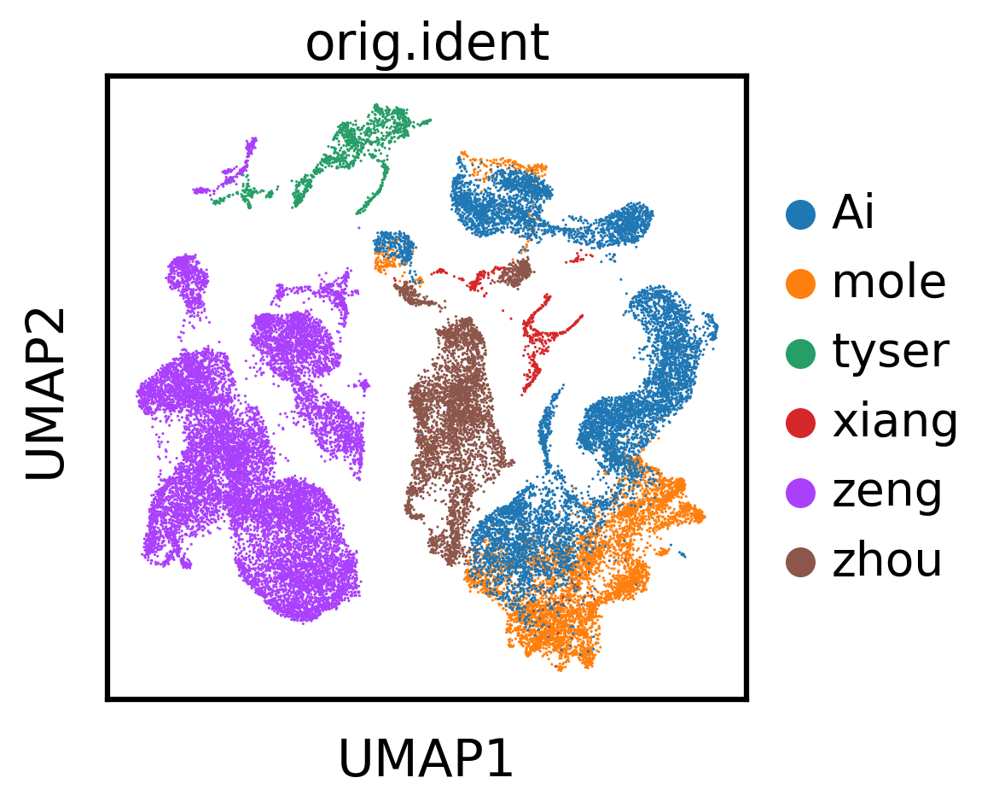

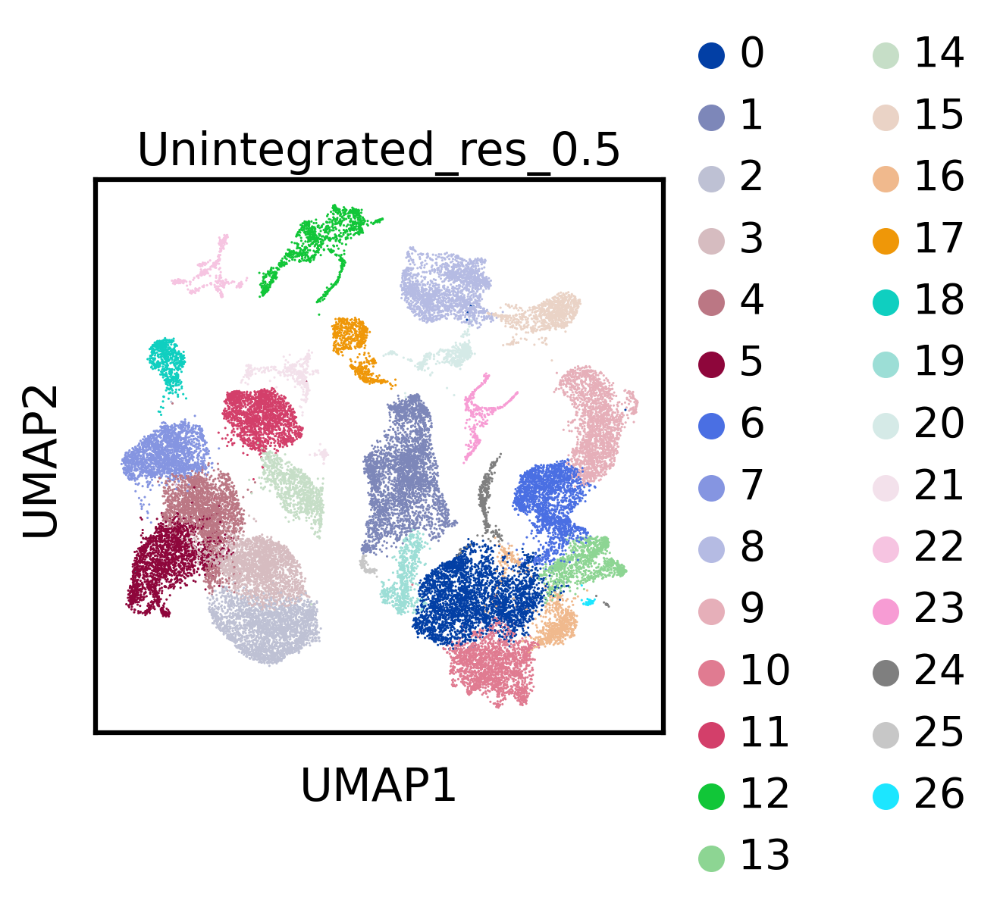

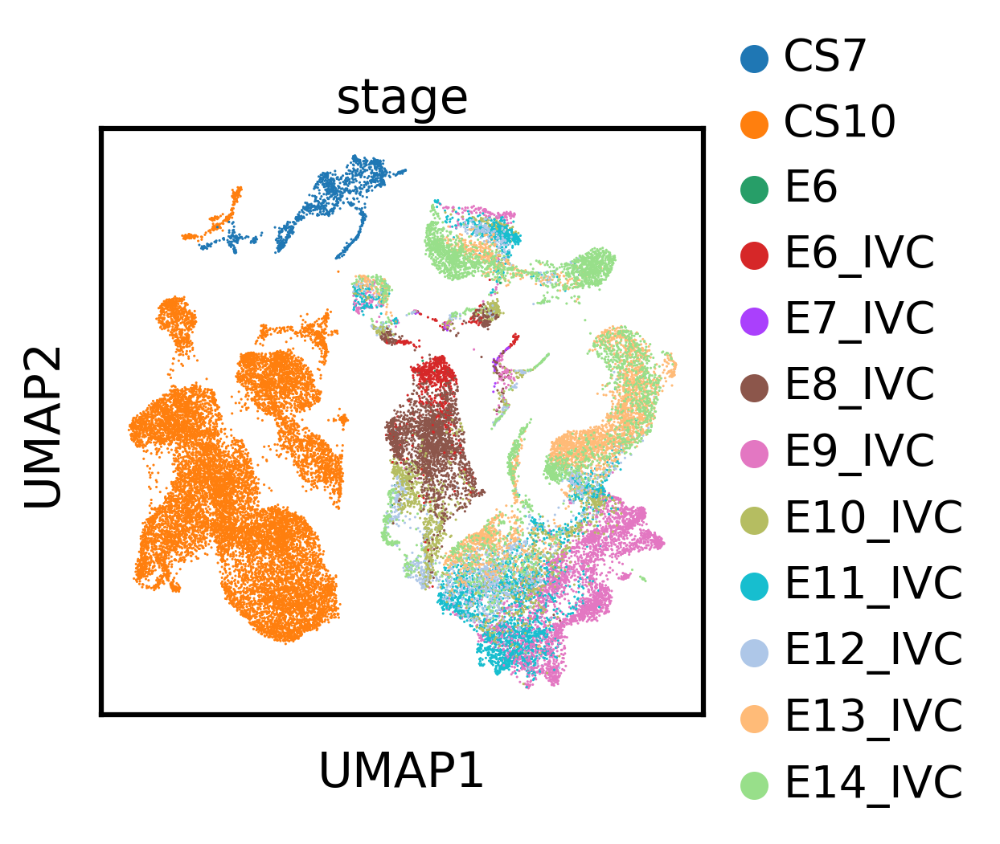

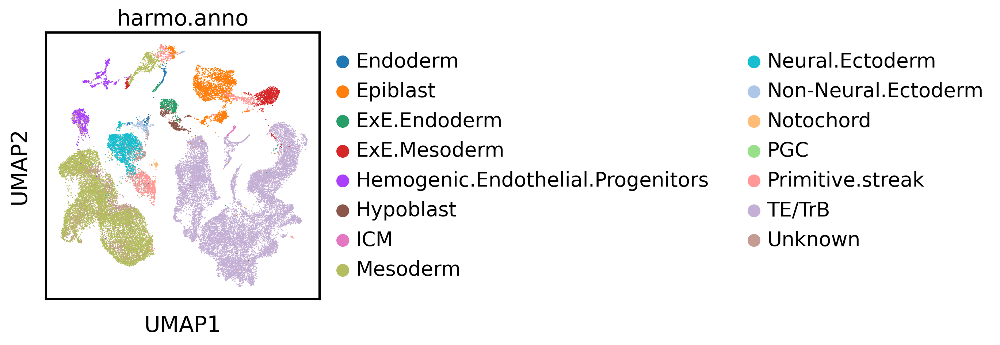

In [22]:
####Unintegrated
adata.obsm["Unintegrated"] = adata_hvg.obsm["X_pca"]
adata_hvg.obsm["Unintegrated"] = adata_hvg.obsm["X_pca"]
sc.pp.neighbors(adata, use_rep="Unintegrated",random_state=42)
sc.tl.leiden(adata, resolution=0.5,key_added=f"Unintegrated_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_Unintegrated'] = adata.obsm['X_umap']
sc.pl.umap(adata, color=['orig.ident'], save="Unintegrated_orig_ident.pdf")
sc.pl.umap(adata, color=['Unintegrated_res_0.5'], save="Unintegrated_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'], save="Unintegrated_stage.pdf")
sc.pl.umap(adata, color=['harmo.anno'], save="Unintegrated_harmo.anno.pdf")

In [23]:
adata

AnnData object with n_obs × n_vars = 34387 × 60421
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score', 'Unintegrated_res_0.5'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'umap', 'orig.ident_colors', 'Unintegrated_res_0.5_colors', 'stage_colors', 'harmo.anno_colors'
    obsm: 'X_pca', 'Unintegrated', 'X_umap', 'X_Unintegrated'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

In [24]:
###Scanorama
import scanorama
batch_cats = adata_hvg.obs['orig.ident'].cat.categories
adata_list = [adata_hvg[adata_hvg.obs['orig.ident'] == b].copy() for b in batch_cats]
scanorama.integrate_scanpy(adata_list)

adata.obsm["Scanorama"] = np.zeros((adata_hvg.shape[0], adata_list[0].obsm["X_scanorama"].shape[1]))
for i, b in enumerate(batch_cats):
    adata.obsm["Scanorama"][adata_hvg.obs['orig.ident'] == b] = adata_list[i].obsm["X_scanorama"]

Found 2000 genes among all datasets
[[0.         0.57938931 0.06951424 0.07089552 0.02623774 0.11667843]
 [0.         0.         0.         0.2891791  0.         0.44154317]
 [0.         0.         0.         0.08395522 0.63902848 0.00083752]
 [0.         0.         0.         0.         0.00932836 0.81156716]
 [0.         0.         0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.         0.        ]]
Processing datasets (3, 5)
Processing datasets (2, 4)
Processing datasets (0, 1)
Processing datasets (1, 5)
Processing datasets (1, 3)
Processing datasets (0, 5)


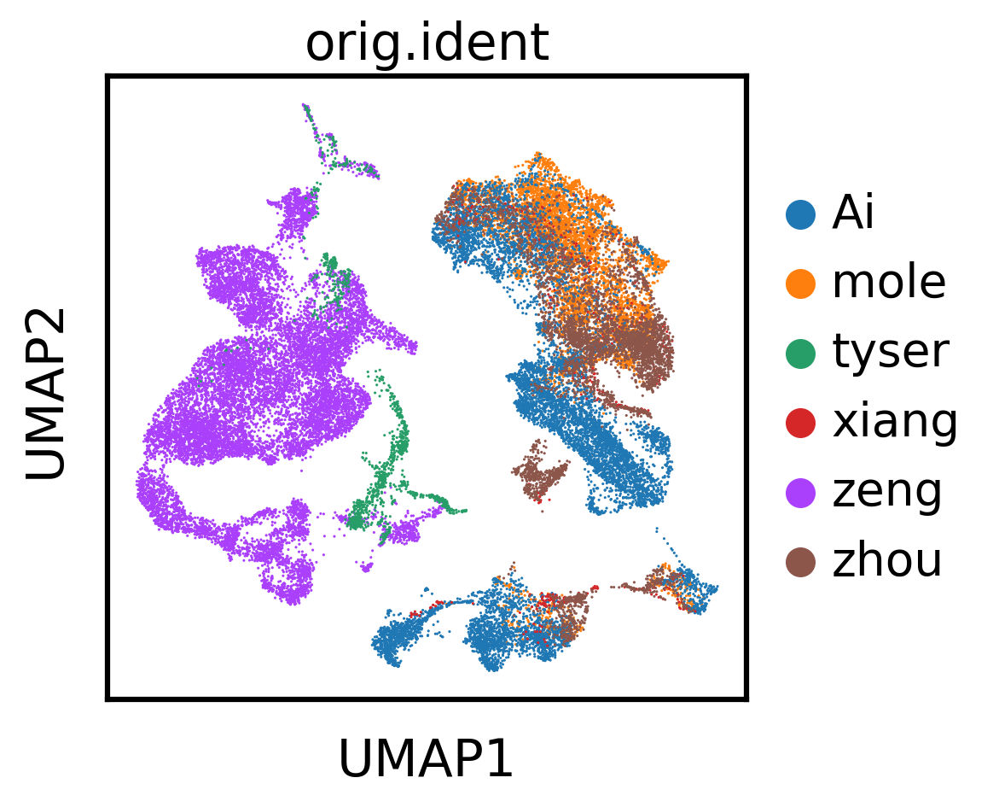

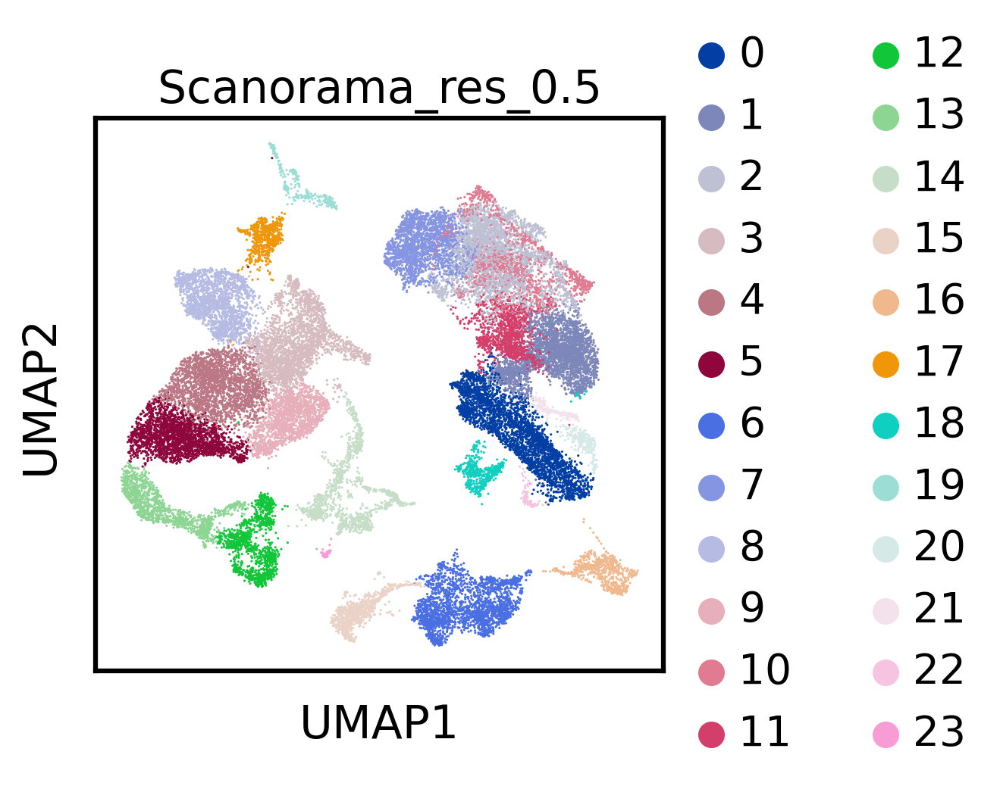

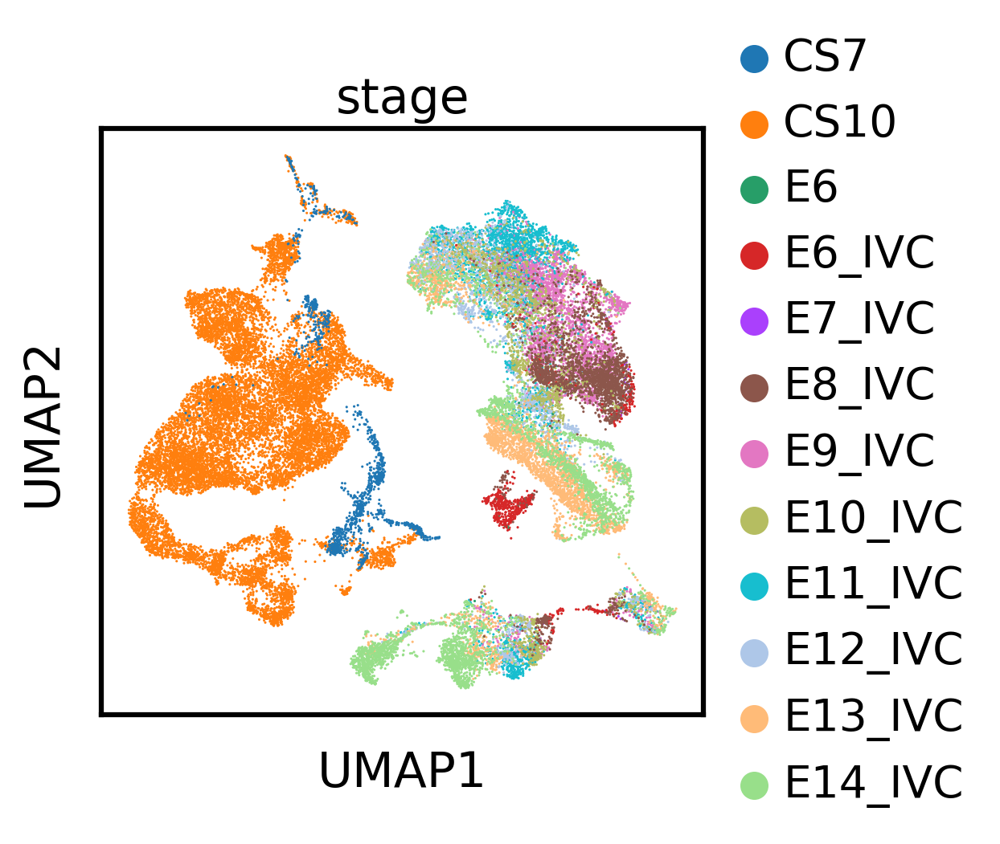

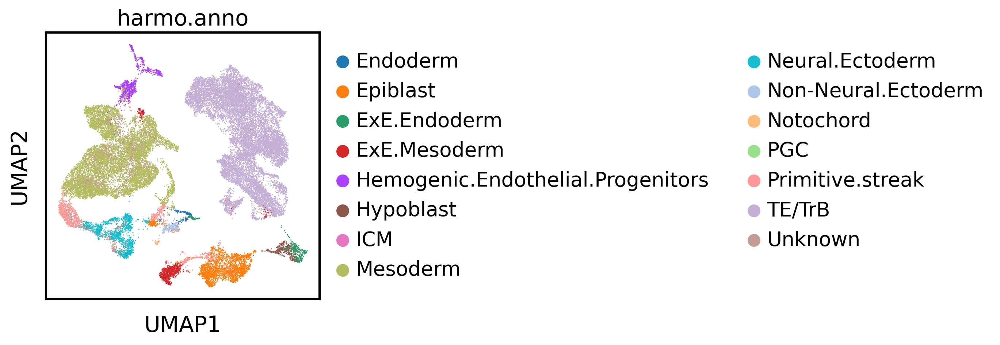

In [25]:
adata_hvg.obsm["Scanorama"] = adata.obsm["Scanorama"]
sc.pp.neighbors(adata, use_rep="Scanorama",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"Scanorama_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_Scanorama'] = adata.obsm['X_umap']
adata_hvg.obsm['X_Scanorama'] = adata.obsm['X_umap']
sc.pl.umap(adata, color=['orig.ident'], save="Scanorama_orig_ident.pdf")
sc.pl.umap(adata, color=['Scanorama_res_0.5'], save="Scanorama_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'], save="Scanorama_stage.pdf")
sc.pl.umap(adata, color=['harmo.anno'], save="Scanorama_harmo.anno.pdf")

In [26]:
####Liger
bdata = adata_hvg.copy()
# Pyliger normalizes by library size with a size factor of 1
# So here we give it the count data
bdata.X = bdata.layers["counts"]
# List of adata per batch
adata_list = [bdata[bdata.obs['orig.ident'] == b].copy() for b in batch_cats]
for i, ad in enumerate(adata_list):
    ad.uns["sample_name"] = batch_cats[i]
    # Hack to make sure each method uses the same genes
    ad.uns["var_gene_idx"] = np.arange(bdata.n_vars)

liger_data = pyliger.create_liger(adata_list, remove_missing=False, make_sparse=False)
# Hack to make sure each method uses the same genes
liger_data.var_genes = bdata.var_names
pyliger.normalize(liger_data)
pyliger.scale_not_center(liger_data)
pyliger.optimize_ALS(liger_data, k=30)
pyliger.quantile_norm(liger_data)

adata.obsm["LIGER"] = np.zeros((adata_hvg.shape[0], liger_data.adata_list[0].obsm["H_norm"].shape[1]))
for i, b in enumerate(batch_cats):
    adata.obsm["LIGER"][adata_hvg.obs['orig.ident'] == b] = liger_data.adata_list[i].obsm["H_norm"]

/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/pyliger/preprocessing/_scale.py:88: RuntimeWarning: divide by zero encountered in divide
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [04:41<00:00,  9.37s/it]


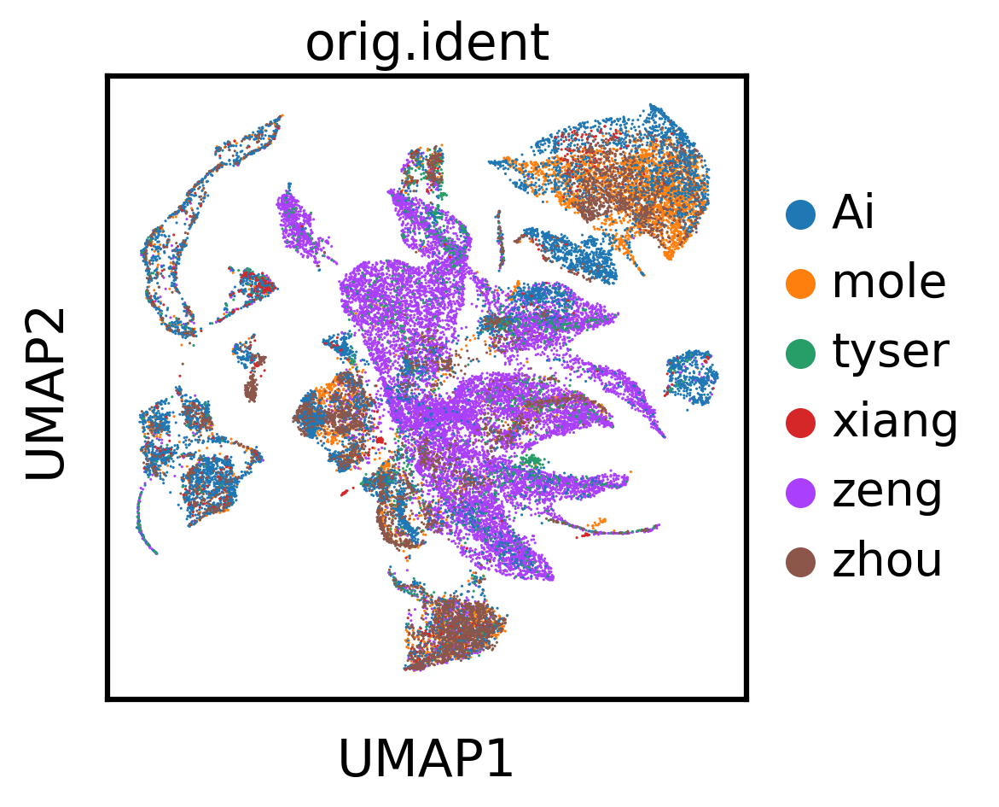

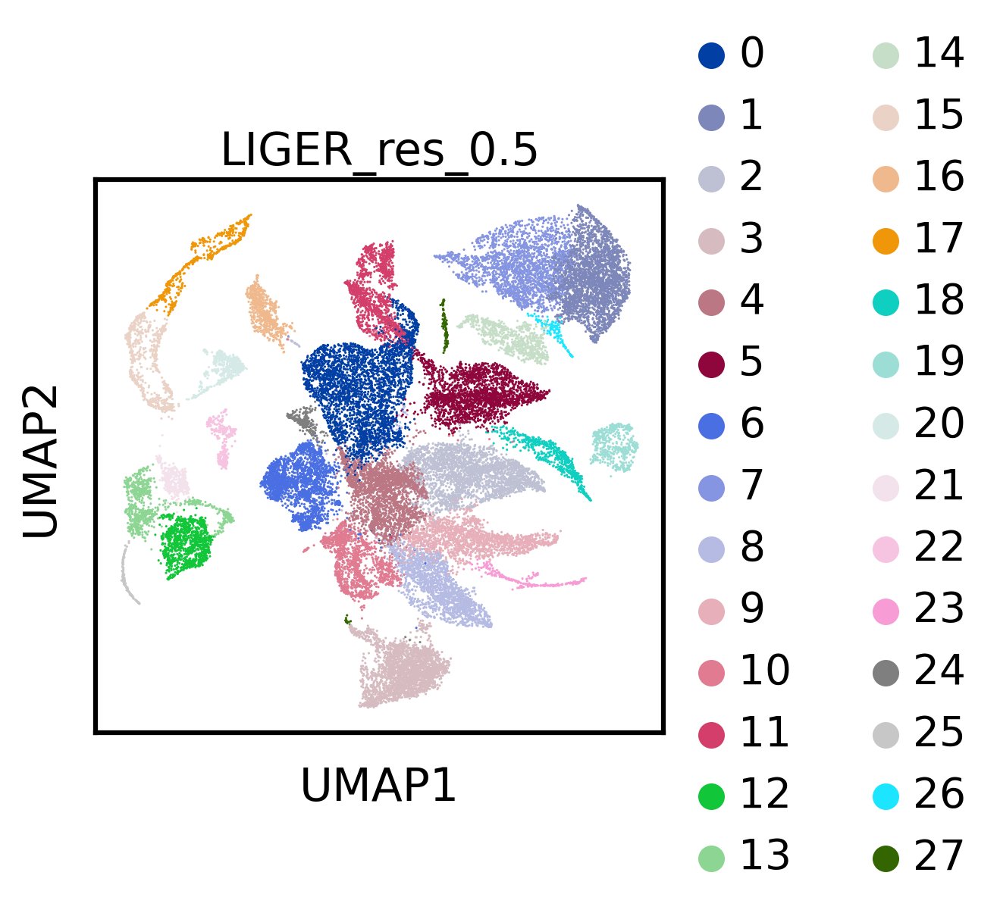

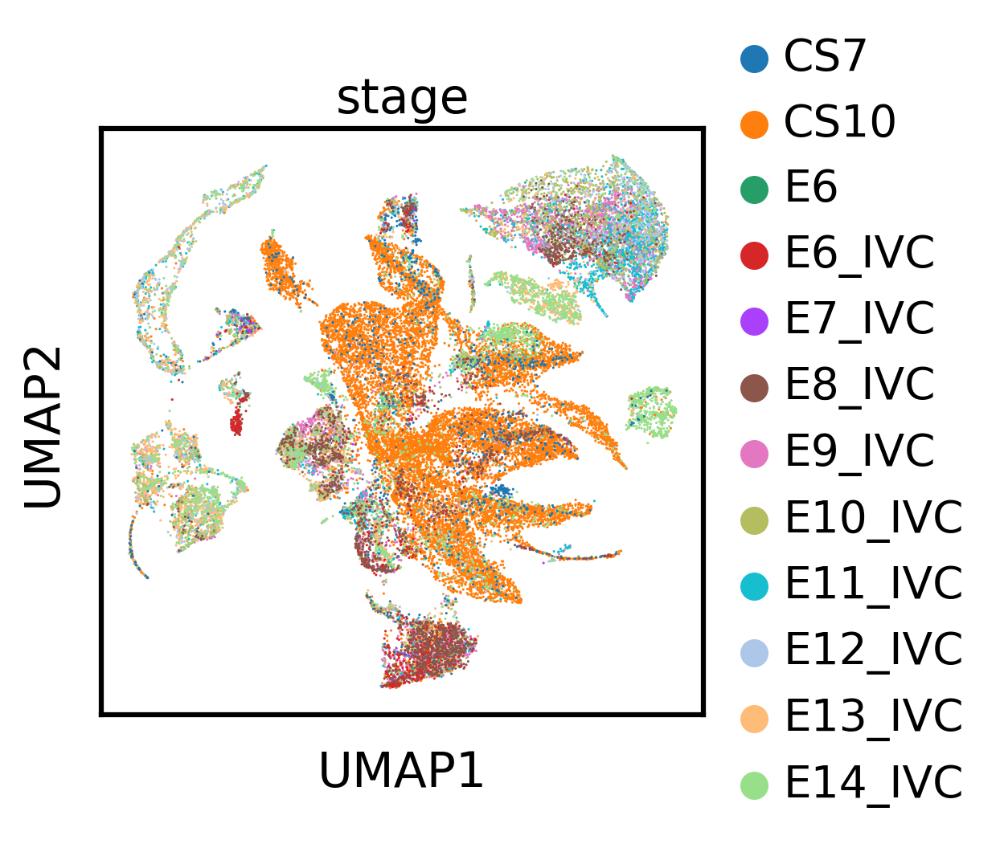

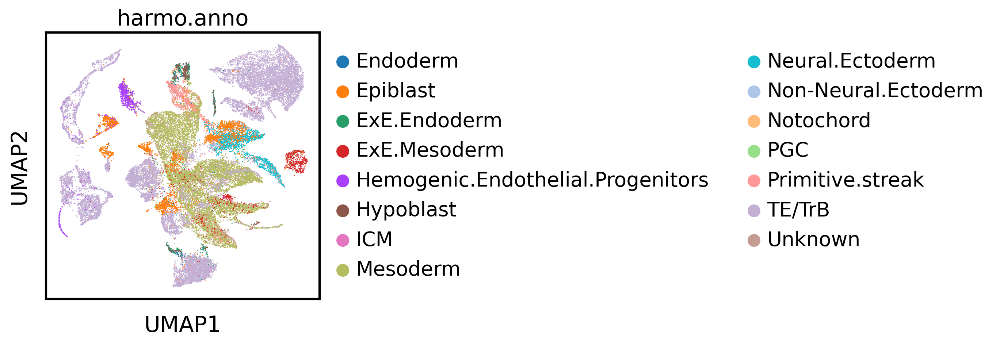

In [27]:
adata_hvg.obsm["LIGER"] = adata.obsm["LIGER"]
sc.pp.neighbors(adata, use_rep="LIGER",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"LIGER_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_LIGER'] = adata.obsm['X_umap']
adata_hvg.obsm['X_LIGER'] = adata.obsm['X_LIGER']
sc.pl.umap(adata, color=['orig.ident'],save="Liger_orig.ident.pdf")
sc.pl.umap(adata, color=['LIGER_res_0.5'],save="Liger_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="Liger_stage.pdf")
sc.pl.umap(adata, color=['harmo.anno'],save="Liger_harmo.anno.pdf")

In [28]:
###harmony
adata.obsm["Harmony"] = harmonize(adata_hvg.obsm["X_pca"], adata_hvg.obs, batch_key="orig.ident")

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
Reach convergence after 5 iteration(s).


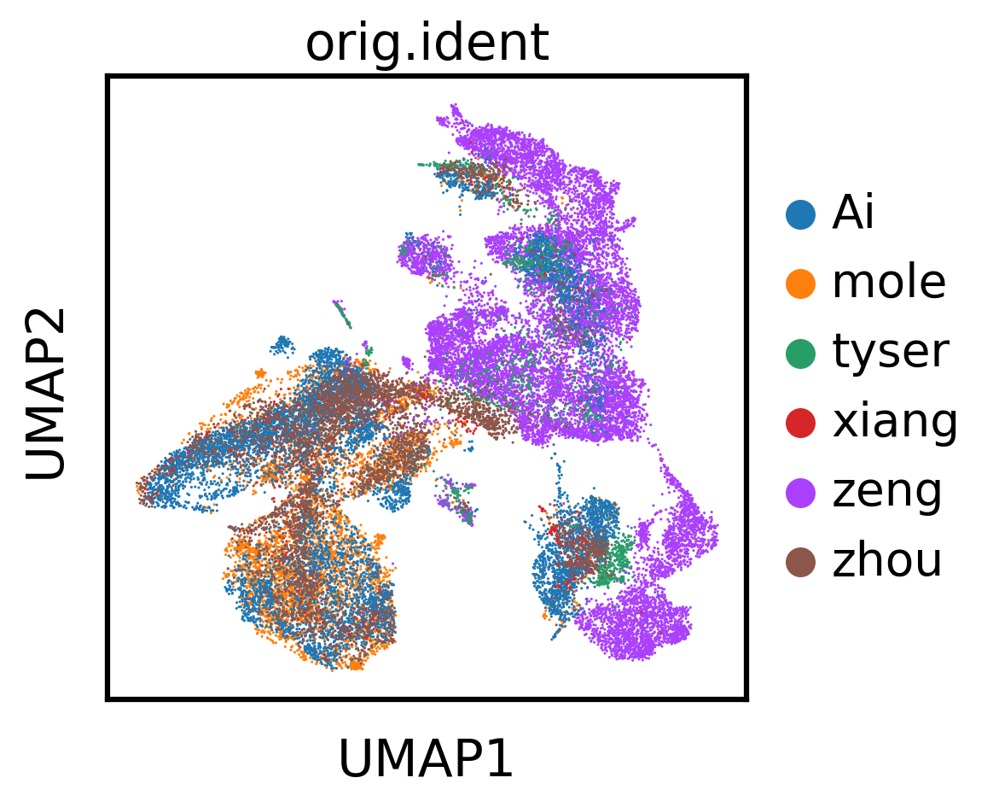

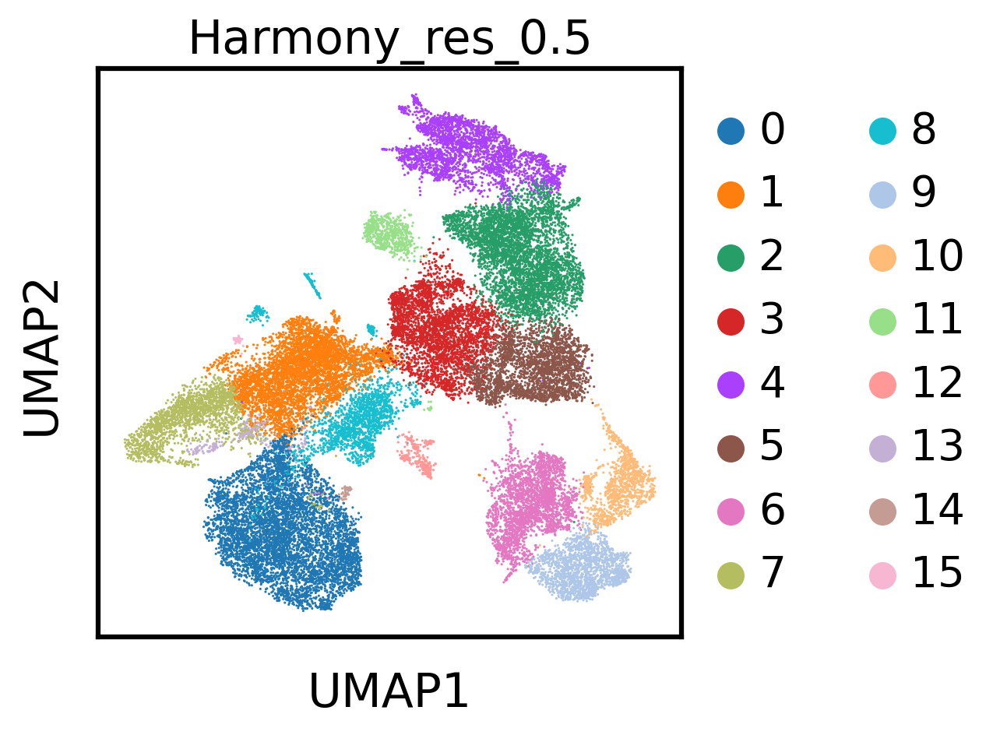

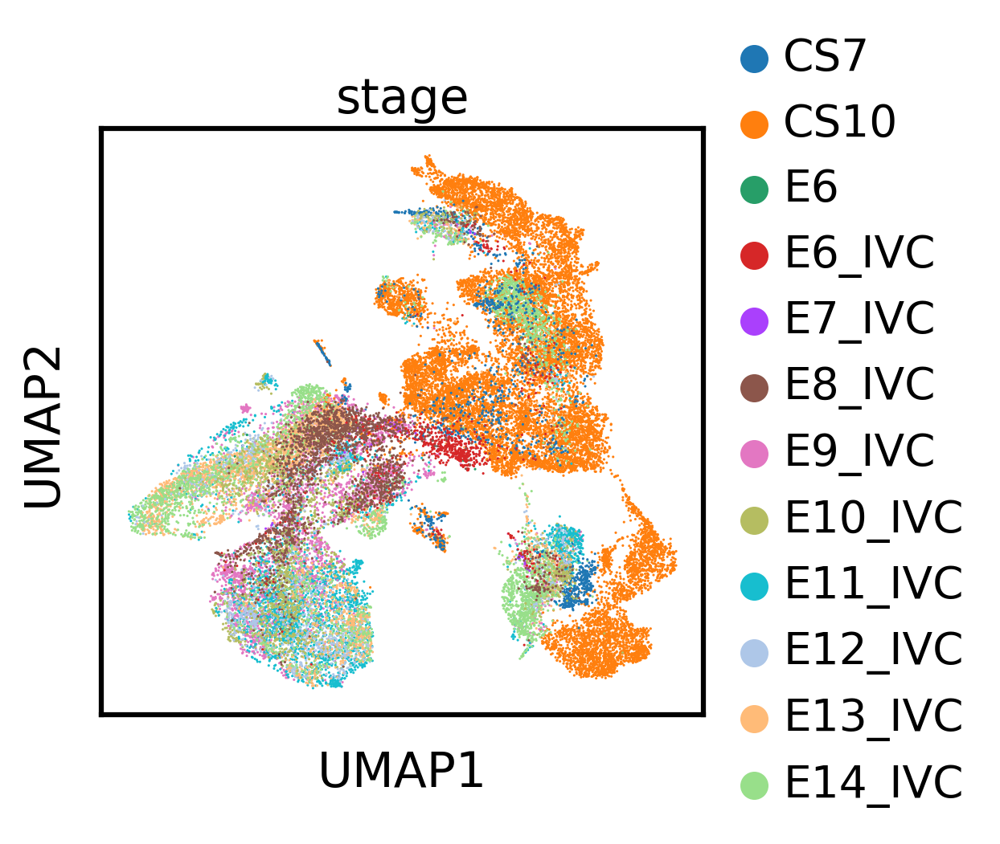

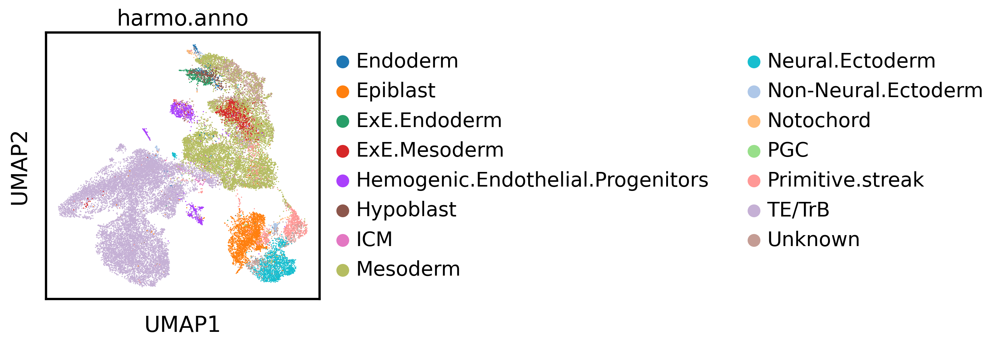

In [29]:
adata_hvg.obsm["Harmony"] = adata.obsm["Harmony"]
sc.pp.neighbors(adata, use_rep="Harmony",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"Harmony_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_Harmony'] = adata.obsm['X_umap']
adata_hvg.obsm['X_Harmony'] = adata.obsm['X_Harmony']
sc.pl.umap(adata, color=['orig.ident'],save="Harmony_orig.ident.pdf")
sc.pl.umap(adata, color=['Harmony_res_0.5'],save="Harmony_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="Harmony_stage.pdf")
sc.pl.umap(adata, color=['harmo.anno'],save="Harmony_harmo.anno.pdf")

In [30]:
print(adata.layers["counts"])

(0, 4)        1.0
  (0, 10)       1.0
  (0, 12)       2.0
  (0, 20)       9.0
  (0, 22)       1.0
  (0, 25)       5.0
  (0, 26)       9.0
  (0, 28)       2.0
  (0, 31)       4.0
  (0, 39)       9.0
  (0, 40)       2.0
  (0, 43)       14.0
  (0, 46)       2.0
  (0, 47)       6.0
  (0, 48)       6.0
  (0, 53)       1.0
  (0, 54)       55.0
  (0, 55)       3.0
  (0, 56)       2.0
  (0, 57)       34.0
  (0, 63)       8.0
  (0, 65)       9.0
  (0, 66)       4.0
  (0, 68)       34.0
  (0, 75)       5.0
  :     :
  (34386, 54555)        2.0
  (34386, 54602)        2.0
  (34386, 54741)        3.0
  (34386, 54995)        1.0
  (34386, 55690)        1.0
  (34386, 55793)        1.0
  (34386, 55885)        1.0
  (34386, 56090)        39.0
  (34386, 56246)        1.0
  (34386, 56289)        1.0
  (34386, 56587)        1.0
  (34386, 56664)        2.0
  (34386, 56864)        1.0
  (34386, 56957)        1.0
  (34386, 57063)        4.0
  (34386, 57510)        2.0
  (34386, 57591)        1.0
  (34386, 57708)        3.0
  (34386, 57788)        1.0
  (34386, 57953)        1.0
  (34386, 57958)        1.0
  (34386, 58802)        1.0
  (34386, 58833)        1.0
  (34386, 60398)        49.0
  (34386, 60400)        104.0

In [31]:
###scVI
scvi.model.SCVI.setup_anndata(adata_hvg, layer="counts", batch_key="orig.ident")
vae = scvi.model.SCVI(adata_hvg, gene_likelihood="nb", n_layers=2, n_latent=30)
vae.train()
adata.obsm["scVI"] = vae.get_latent_representation()

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 233/233: 100%|██████████████████████████████████████████████████████████████████████| 233/233 [11:41<00:00,  3.08s/it, loss=1.26e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=233` reached.


Epoch 233/233: 100%|██████████████████████████████████████████████████████████████████████| 233/233 [11:41<00:00,  3.01s/it, loss=1.26e+03, v_num=1]


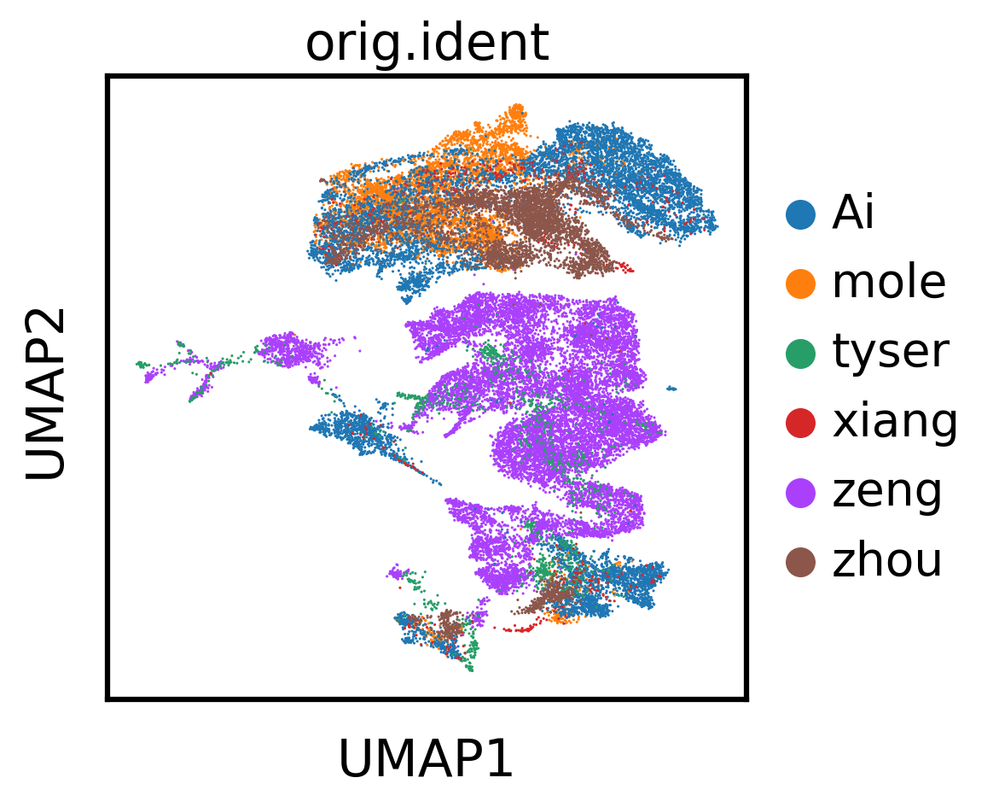

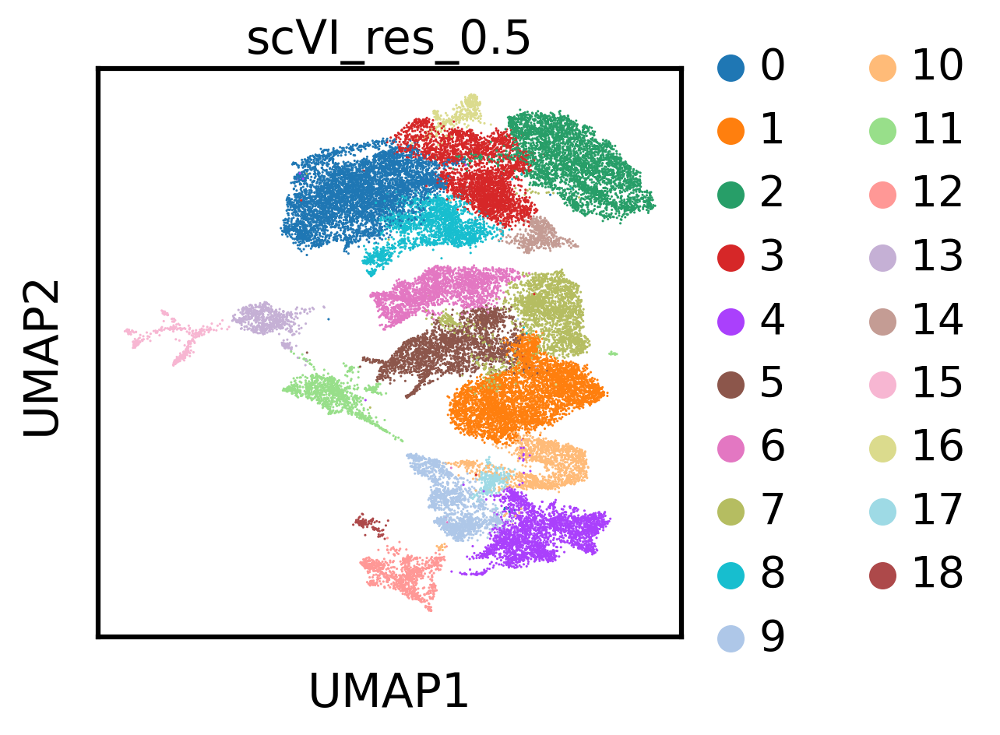

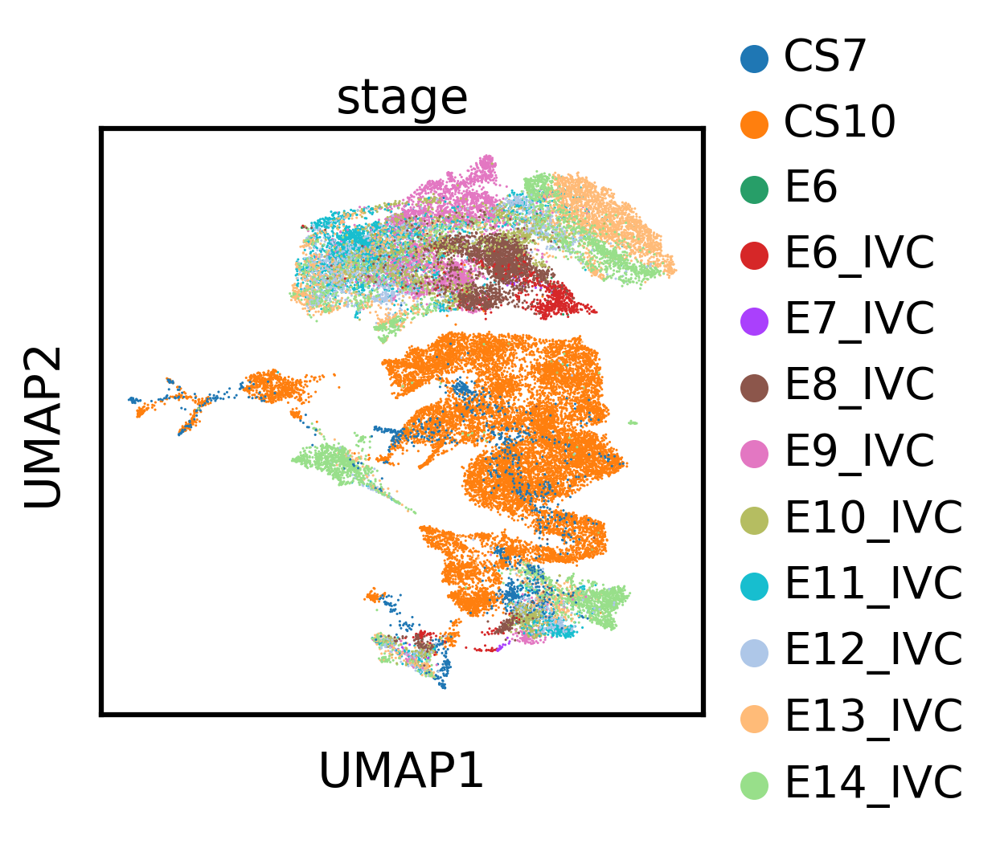

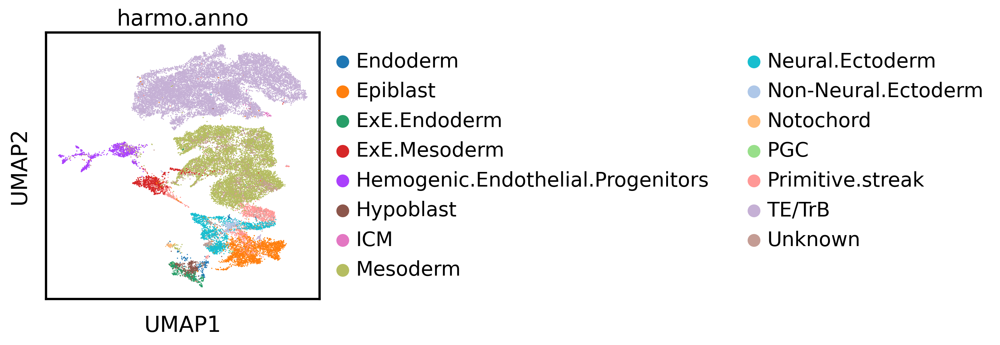

In [32]:
adata_hvg.obsm["scVI"] = adata.obsm["scVI"]
sc.pp.neighbors(adata, use_rep="scVI",random_state=42)
sc.tl.leiden(adata, resolution=0.5,key_added=f"scVI_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_scVI'] = adata.obsm['X_umap']
adata_hvg.obsm['X_scVI'] = adata.obsm['X_scVI']
sc.pl.umap(adata, color=['orig.ident'],save="scVI_orig.ident.pdf")
sc.pl.umap(adata, color=['scVI_res_0.5'],save="scVI_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="scVI_stage.pdf")
sc.pl.umap(adata, color=['harmo.anno'],save="scVI_harmo.anno.pdf")

In [33]:
###scANVI
lvae = scvi.model.SCANVI.from_scvi_model(
    vae,
    adata=adata_hvg,
    labels_key="harmo.anno",
    unlabeled_category="Unknown",
)
lvae.train(max_epochs=20, n_samples_per_label=100)
adata.obsm["scANVI"] = lvae.get_latent_representation()

INFO     Training for 20 epochs.                                                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 20/20: 100%|██████████████████████████████████████████████████████████████████████████| 20/20 [02:20<00:00,  6.76s/it, loss=1.32e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|██████████████████████████████████████████████████████████████████████████| 20/20 [02:20<00:00,  7.02s/it, loss=1.32e+03, v_num=1]


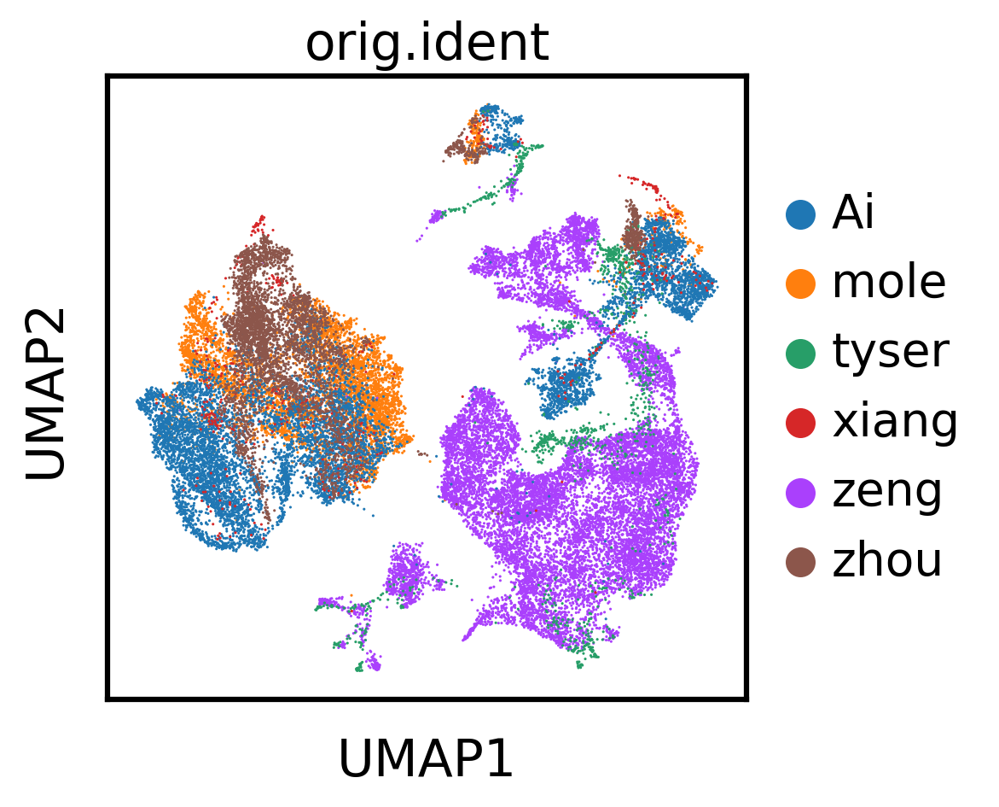

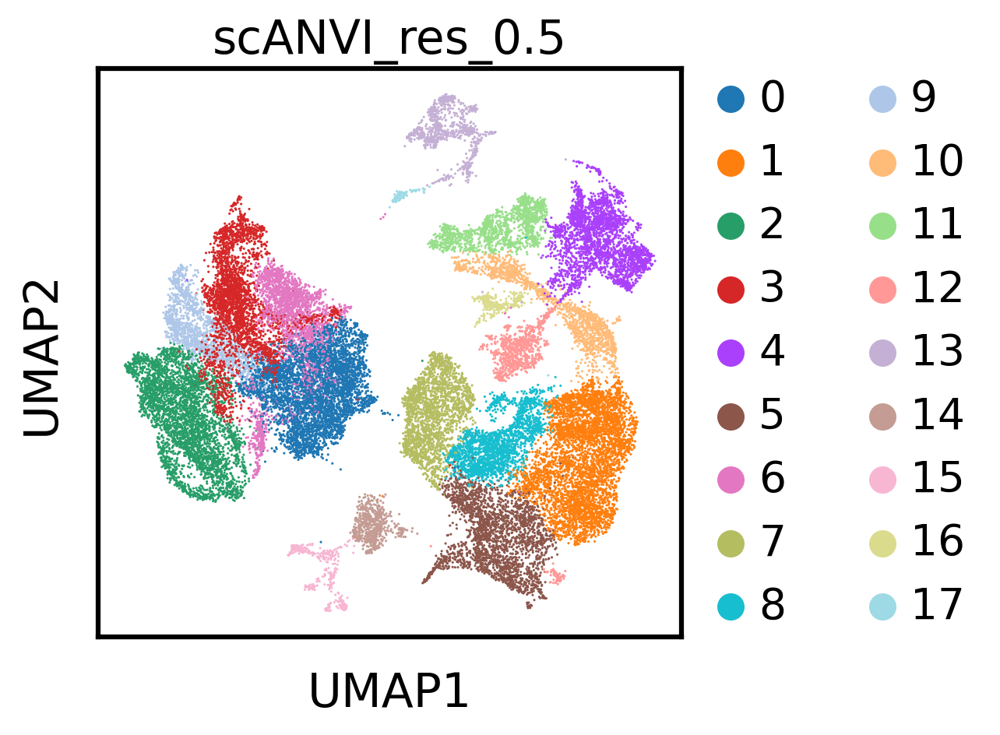

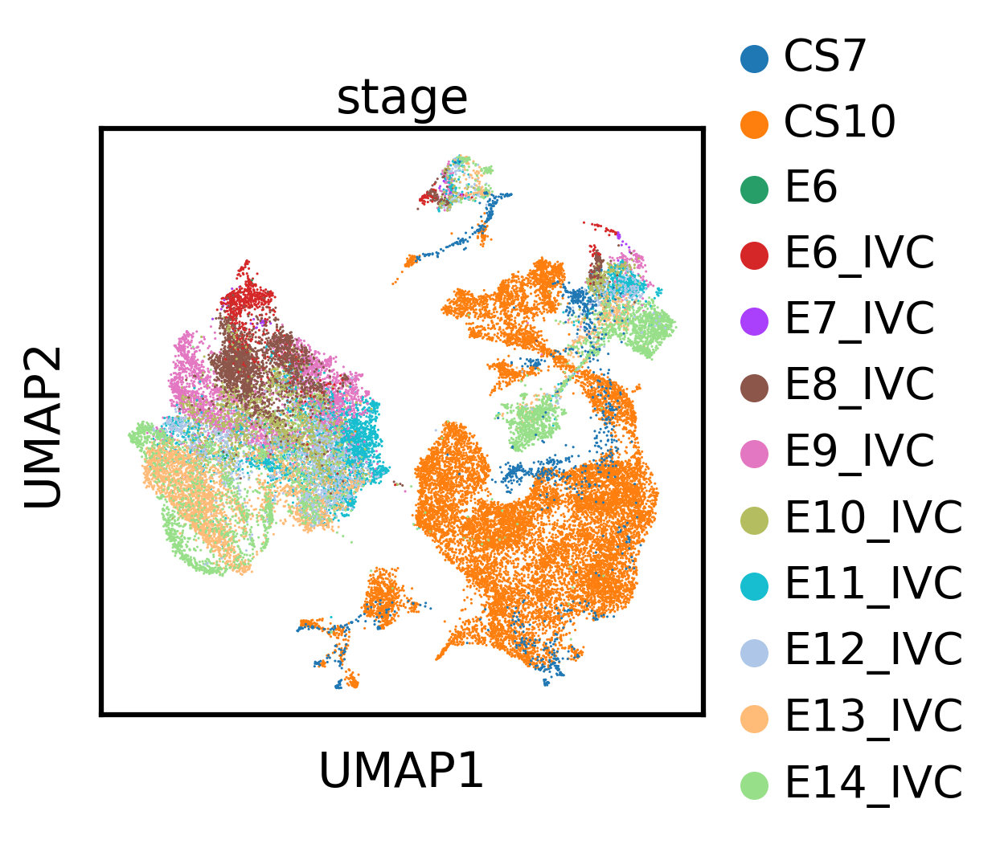

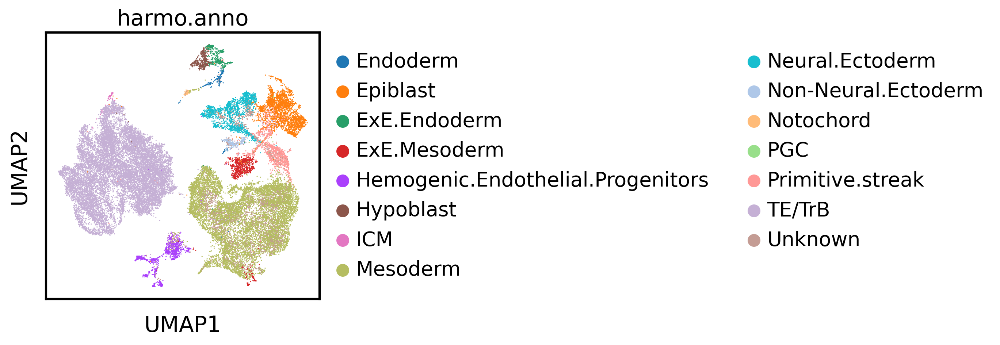

In [34]:
adata_hvg.obsm["scANVI"] = adata.obsm["scANVI"]
sc.pp.neighbors(adata, use_rep="scANVI",random_state=42)
sc.tl.leiden(adata, resolution=0.5,key_added=f"scANVI_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_scANVI'] = adata.obsm['X_umap']
adata_hvg.obsm['X_scANVI'] = adata.obsm['X_scANVI']
sc.pl.umap(adata, color=['orig.ident'],save="scANVI_orig.ident.pdf")
sc.pl.umap(adata, color=['scANVI_res_0.5'],save="scANVI_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="scANVI_stage.pdf")
sc.pl.umap(adata, color=['harmo.anno'],save="scANVI_harmo.anno.pdf")

In [35]:
####CCA
adata_seurat = adata_hvg.copy()

adata_seurat.obs["orig.ident"] = adata_seurat.obs["orig.ident"].astype(str)
adata_seurat.obs["harmo.anno"] = adata_seurat.obs["harmo.anno"].astype(str)

del adata_seurat.uns
adata_seurat

AnnData object with n_obs × n_vars = 34387 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score', '_scvi_batch', '_scvi_labels'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'X_pca', 'Unintegrated', 'Scanorama', 'X_Scanorama', 'LIGER', 'X_LIGER', 'Harmony', 'X_Harmony', 'scVI', 'X_scVI', 'scANVI', 'X_scANVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [36]:
#####to R
%R -i adata_seurat
adata_seurat

In addition: Warning messages:
1: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages
2: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages
3: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages
4: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages


AnnData object with n_obs × n_vars = 34387 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score', '_scvi_batch', '_scvi_labels'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'X_pca', 'Unintegrated', 'Scanorama', 'X_Scanorama', 'LIGER', 'X_LIGER', 'Harmony', 'X_Harmony', 'scVI', 'X_scVI', 'scANVI', 'X_scANVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [37]:
%%R -i adata_seurat
library(Seurat)
seurat <- as.Seurat(adata_seurat, counts = "counts", data = "logcounts")
seurat

An object of class Seurat 
2000 features across 34387 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 12 dimensional reductions calculated: PCA, Unintegrated, Scanorama, X_Scanorama, LIGER, X_LIGER, Harmony, X_Harmony, scVI, X_scVI, scANVI, X_scANVI


In [38]:
label_key = "harmo.anno"
batch_key = "orig.ident"

In [39]:
%%R -i batch_key
batch_list <- SplitObject(seurat, split.by = "orig.ident")
batch_list

$mole
An object of class Seurat 
2000 features across 5240 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 12 dimensional reductions calculated: PCA, Unintegrated, Scanorama, X_Scanorama, LIGER, X_LIGER, Harmony, X_Harmony, scVI, X_scVI, scANVI, X_scANVI

$zeng
An object of class Seurat 
2000 features across 14400 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 12 dimensional reductions calculated: PCA, Unintegrated, Scanorama, X_Scanorama, LIGER, X_LIGER, Harmony, X_Harmony, scVI, X_scVI, scANVI, X_scANVI

$Ai
An object of class Seurat 
2000 features across 8766 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 12 dimensional reductions calculated: PCA, Unintegrated, Scanorama, X_Scanorama, LIGER, X_LIGER, Harmony, X_Harmony, scVI, X_scVI, scANVI, X_scANVI

$tyser
An object 

In [40]:
%%R
anchors <- FindIntegrationAnchors(batch_list, anchor.features = rownames(seurat))
anchors

  |                                                  | 0 % ~calculating   |+++++++++                                         | 17% ~02s           |+++++++++++++++++                                 | 33% ~04s           |+++++++++++++++++++++++++                         | 50% ~02s           |++++++++++++++++++++++++++++++++++                | 67% ~01s           |++++++++++++++++++++++++++++++++++++++++++        | 83% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=03s  
  |                                                  | 0 % ~calculating   |++++                                              | 7 % ~22m 53s       |+++++++                                           | 13% ~17m 23s       |++++++++++                                        | 20% ~30m 38s       |++++++++++++++                                    | 27% ~22m 19s       |+++++++++++++++++                                 | 33% ~18m 42s       |++++++++++++++++++++                              | 40% ~15

Scaling features for provided objects
Finding all pairwise anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 17980 anchors
Filtering anchors
	Retained 1605 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 12695 anchors
Filtering anchors
	Retained 5695 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 20300 anchors
Filtering anchors
	Retained 2811 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 4709 anchors
Filtering anchors
	Retained 1997 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 4673 anchors
Filtering anchors
	Retained 3549 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 4366 anchors
Filtering anchors
	Retained 2535 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 2104 anchors
Filtering anchors
	Retained 1891 anchors
Running CCA
Merging objects
Finding neigh

In [41]:
%%R
integrated <- IntegrateData(anchors)
integrated

An object of class Seurat 
4000 features across 34387 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 1 layer present: data
 1 other assay present: originalexp


Merging dataset 5 into 3
Extracting anchors for merged samples
Finding integration vectors
Finding integration vector weights
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Integrating data
Merging dataset 4 into 2
Extracting anchors for merged samples
Finding integration vectors
Finding integration vector weights
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Integrating data
Merging dataset 6 into 1
Extracting anchors for merged samples
Finding integration vectors
Finding integration vector weights
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Integrating data
Merging dataset 3 5 into 1 6
Extracting anchors for merged samples
Finding integration vectors

In [42]:
%%R
integrated

An object of class Seurat 
4000 features across 34387 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 1 layer present: data
 1 other assay present: originalexp


In [43]:
%%R -o integrated_expr
integrated_expr <- GetAssayData(integrated)

integrated_expr <- integrated_expr[rownames(seurat), colnames(seurat)]

integrated_expr <- t(integrated_expr)
print(integrated_expr[1:10, 1:10])

10 x 10 sparse Matrix of class "dgCMatrix"
                                                                               
AAACCTGAGACGCTTT-1_1_1_1_1_1_1 0.5896575 0.08550169 . 0.08550169 . 0.58965746 .
AACGTTGAGACGCAAC-1_1_1_1_1_1_1 .         1.90696144 . .          . 0.85653149 .
AACTCAGCAGACGCCT-1_1_1_1_1_1_1 .         1.33391489 . 0.05140802 . 0.05140802 .
AAGACCTTCGGCGCTA-1_1_1_1_1_1_1 .         1.08428690 . .          . 0.33035790 .
AAGCCGCCATATGGTC-1_1_1_1_1_1_1 0.3816366 .          . .          . 0.38163658 .
AAGTCTGAGTACGCGA-1_1_1_1_1_1_1 .         0.09942714 . .          . 0.98305474 .
AATCCAGAGTTGAGTA-1_1_1_1_1_1_1 0.6001404 2.05454423 . .          . .          .
AATCCAGTCCAGAGGA-1_1_1_1_1_1_1 0.3608647 0.31662518 . .          . 0.36086472 .
ACACCCTGTCTACCTC-1_1_1_1_1_1_1 .         0.59277202 . .          . .          .
ACATCAGTCTGTCCGT-1_1_1_1_1_1_1 0.2014149 0.28870517 . .          . 1.02426828 .
                                                      
AAACCTGAGACGCTTT-1_1_1

  [[ suppressing 10 column names ‘ISG15’, ‘PRKCZ’, ‘PLCH2’ ... ]]


In [44]:
## save to adata key
adata_seurat.X = integrated_expr
adata_seurat.layers["seurat"] = integrated_expr
print(adata_seurat)
adata.X

AnnData object with n_obs × n_vars = 34387 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 
'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score', '_scvi_batch', '_scvi_labels'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 
'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'X_pca', 'Unintegrated', 'Scanorama', 'X_Scanorama', 'LIGER', 'X_LIGER', 'Harmony', 'X_Harmony', 'scVI', 
'X_scVI', 'scANVI', 'X_scANVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts', 'seurat'

<34387x60421 sparse matrix of type '<class 'numpy.float64'>'
	with 175305840 stored elements in Compressed Sparse Row format>

In [45]:
sc.tl.pca(adata_seurat)
adata.obsm["CCA"] = adata_seurat.obsm["X_pca"]
adata_hvg.obsm["CCA"] = adata_seurat.obsm["X_pca"]

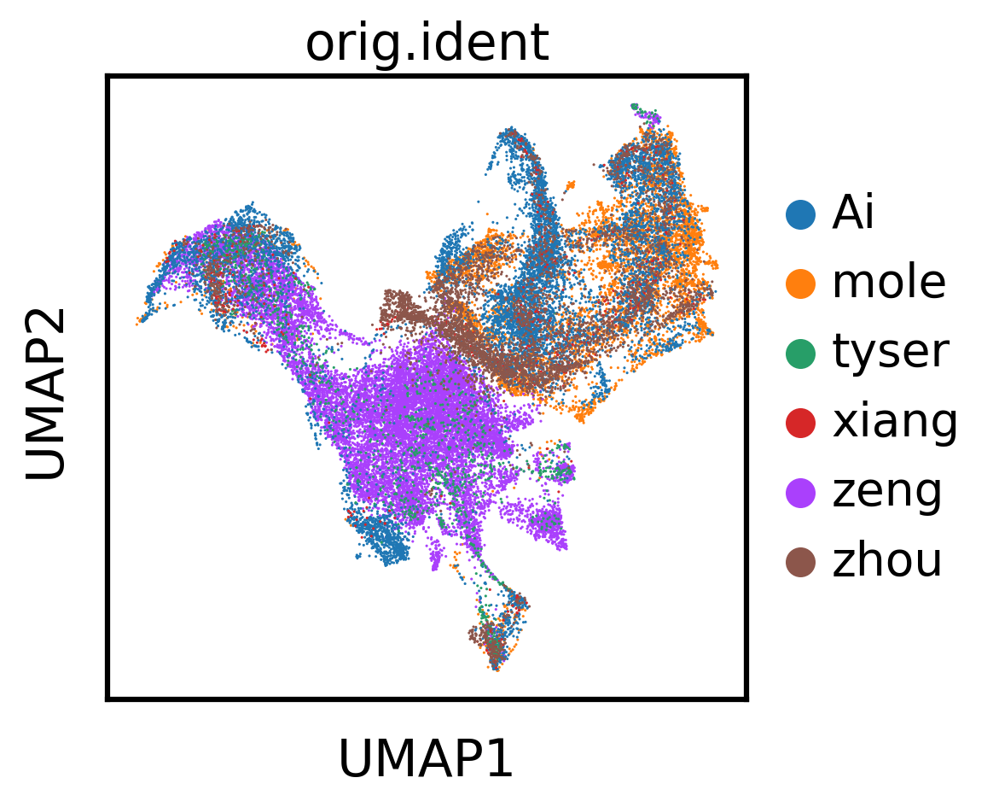

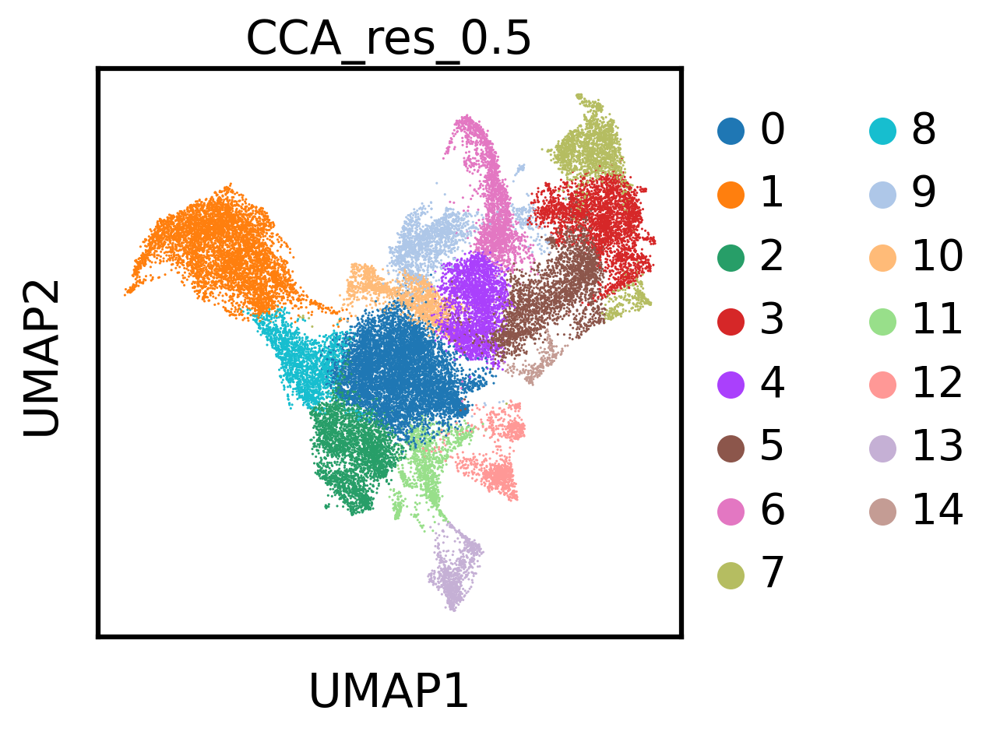

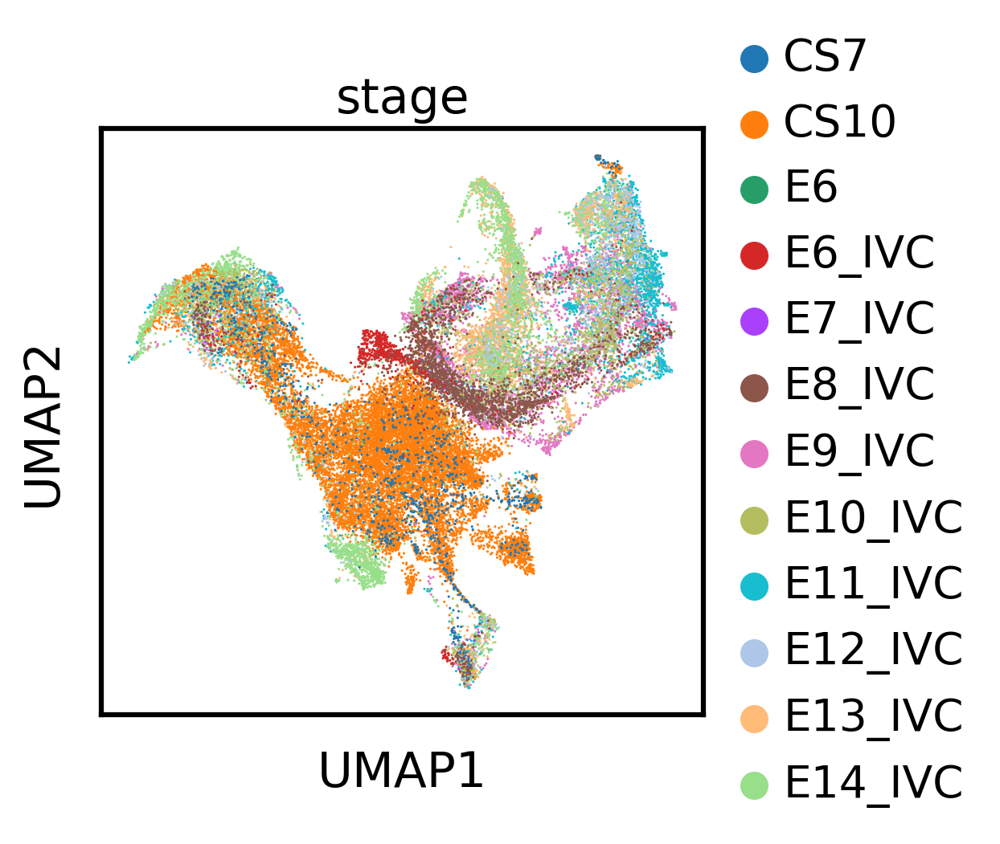

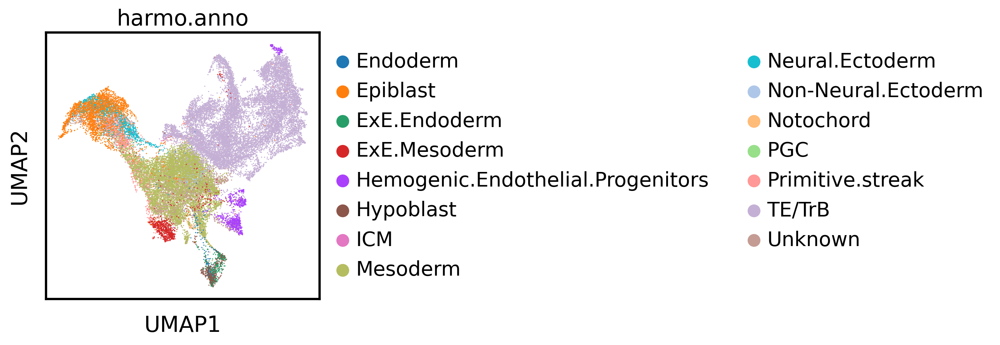

In [46]:
sc.pp.neighbors(adata, use_rep="CCA",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"CCA_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_CCA'] = adata.obsm['X_umap']
adata_hvg.obsm['X_CCA'] = adata.obsm['X_CCA']
sc.pl.umap(adata, color=['orig.ident'],save="CCA_orig.ident.pdf")
sc.pl.umap(adata, color=['CCA_res_0.5'],save="CCA_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="CCA_stage.pdf")
sc.pl.umap(adata, color=['harmo.anno'],save="CCA_harmo.anno.pdf")

In [47]:
###fastmnn
adata_fastmnn = adata_hvg.copy()
adata_fastmnn

AnnData object with n_obs × n_vars = 34387 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score', '_scvi_batch', '_scvi_labels'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'X_pca', 'Unintegrated', 'Scanorama', 'X_Scanorama', 'LIGER', 'X_LIGER', 'Harmony', 'X_Harmony', 'scVI', 'X_scVI', 'scANVI', 'X_scANVI', 'CCA', 'X_CCA'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [48]:
adata_fastmnn.obs["orig.ident"] = adata_fastmnn.obs["orig.ident"].astype(str)
adata_fastmnn.obs["harmo.anno"] = adata_fastmnn.obs["harmo.anno"].astype(str)

del adata_fastmnn.uns
adata_fastmnn

AnnData object with n_obs × n_vars = 34387 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score', '_scvi_batch', '_scvi_labels'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'X_pca', 'Unintegrated', 'Scanorama', 'X_Scanorama', 'LIGER', 'X_LIGER', 'Harmony', 'X_Harmony', 'scVI', 'X_scVI', 'scANVI', 'X_scANVI', 'CCA', 'X_CCA'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [49]:
#####to R
%R -i adata_fastmnn
adata_fastmnn

AnnData object with n_obs × n_vars = 34387 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score', '_scvi_batch', '_scvi_labels'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'X_pca', 'Unintegrated', 'Scanorama', 'X_Scanorama', 'LIGER', 'X_LIGER', 'Harmony', 'X_Harmony', 'scVI', 'X_scVI', 'scANVI', 'X_scANVI', 'CCA', 'X_CCA'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [50]:
%%R -i adata_fastmnn
library(Seurat)
fastmnn <- as.Seurat(adata_fastmnn, counts = "counts", data = "logcounts")
fastmnn

An object of class Seurat 
2000 features across 34387 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 14 dimensional reductions calculated: PCA, Unintegrated, Scanorama, X_Scanorama, LIGER, X_LIGER, Harmony, X_Harmony, scVI, X_scVI, scANVI, X_scANVI, CCA, X_CCA


In [51]:
label_key = "harmo.anno"
batch_key = "orig.ident"

In [52]:
%%R -i batch_key
batch_list <- SplitObject(fastmnn, split.by = "orig.ident")
batch_list

$mole
An object of class Seurat 
2000 features across 5240 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 14 dimensional reductions calculated: PCA, Unintegrated, Scanorama, X_Scanorama, LIGER, X_LIGER, Harmony, X_Harmony, scVI, X_scVI, scANVI, X_scANVI, CCA, X_CCA

$zeng
An object of class Seurat 
2000 features across 14400 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 14 dimensional reductions calculated: PCA, Unintegrated, Scanorama, X_Scanorama, LIGER, X_LIGER, Harmony, X_Harmony, scVI, X_scVI, scANVI, X_scANVI, CCA, X_CCA

$Ai
An object of class Seurat 
2000 features across 8766 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 14 dimensional reductions calculated: PCA, Unintegrated, Scanorama, X_Scanorama, LIGER, X_LIGER, Harmony, X_Harmony, scVI, X_scVI, scANVI, X_s

In [53]:
%%R
library(Seurat)
library(tidyverse)
library(patchwork)
library(SeuratWrappers)
fastmnn_test <- RunFastMNN(object.list = batch_list)
fastmnn_test

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.0     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ lubridate::%within%() masks IRanges::%within%()
✖ dplyr::collapse()     masks IRanges::collapse()
✖ dplyr::combine()      masks Biobase::combine(), BiocGenerics::combine()
✖ dplyr::count()        masks matrixStats::count()
✖ dplyr::desc()         masks IRanges::desc()
✖ tidyr::expand()       masks Matrix::expand(), S4Vectors::expand()
✖ dplyr::filter()       masks stats::filter()
✖ dplyr::first()        masks S4Vectors::first()
✖ dplyr::lag()          masks stats::lag()
✖ tidyr::pack()         masks Matrix::pack()
✖ ggplot2::Position()   masks BiocGenerics::Position(), base::Position()
✖ purrr::reduce()       masks GenomicRanges::reduce(), IRang

Computing 2000 integration features
No variable features found for object1 in the object.list. Running FindVariableFeatures ...
Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
No variable features found for object2 in the object.list. Running FindVariableFeatures ...
Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
************

In [54]:
%%R
fastmnn_test

An object of class Seurat 
4000 features across 34387 samples within 2 assays 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: mnn.reconstructed
 1 dimensional reduction calculated: mnn


In [55]:
%%R -o fastmnn_expr
fastmnn_expr <- GetAssayData(fastmnn_test, assay = "mnn.reconstructed")

fastmnn_expr <- fastmnn_expr[rownames(fastmnn), colnames(fastmnn)]

fastmnn_expr <- t(fastmnn_expr)
print(fastmnn_expr[1:10, 1:10])

10 x 10 sparse Matrix of class "dgCMatrix"
                                                                      
AAACCTGAGACGCTTT-1_1_1_1_1_1_1  0.010360645 -0.014175691  2.120550e-05
AACGTTGAGACGCAAC-1_1_1_1_1_1_1 -0.009139406  0.066988887  5.026329e-04
AACTCAGCAGACGCCT-1_1_1_1_1_1_1 -0.005205657  0.041921165 -1.241032e-05
AAGACCTTCGGCGCTA-1_1_1_1_1_1_1 -0.003658899  0.024248352 -9.410507e-06
AAGCCGCCATATGGTC-1_1_1_1_1_1_1  0.006187324 -0.009717584 -3.596015e-04
AAGTCTGAGTACGCGA-1_1_1_1_1_1_1  0.008469462 -0.007852133 -1.592418e-05
AATCCAGAGTTGAGTA-1_1_1_1_1_1_1  0.001302063  0.050035272 -3.131347e-05
AATCCAGTCCAGAGGA-1_1_1_1_1_1_1  0.007436488 -0.003773629  1.117387e-05
ACACCCTGTCTACCTC-1_1_1_1_1_1_1 -0.007741371 -0.007712651 -2.201330e-04
ACATCAGTCTGTCCGT-1_1_1_1_1_1_1  0.006721874  0.003872584 -4.215915e-05
                                                                       
AAACCTGAGACGCTTT-1_1_1_1_1_1_1 -0.0052222987 -6.146021e-05  0.022519212
AACGTTGAGACGCAAC-1_1_1_1_1_1_1  

  [[ suppressing 10 column names ‘ISG15’, ‘PRKCZ’, ‘PLCH2’ ... ]]


In [56]:
## save to adata key
adata_fastmnn.X = fastmnn_expr
adata_fastmnn.layers["fastmnn"] = fastmnn_expr
print(adata_fastmnn)
adata.X

AnnData object with n_obs × n_vars = 34387 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 
'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score', '_scvi_batch', '_scvi_labels'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 
'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'X_pca', 'Unintegrated', 'Scanorama', 'X_Scanorama', 'LIGER', 'X_LIGER', 'Harmony', 'X_Harmony', 'scVI', 
'X_scVI', 'scANVI', 'X_scANVI', 'CCA', 'X_CCA'
    varm: 'PCs'
    layers: 'counts', 'logcounts', 'fastmnn'

<34387x60421 sparse matrix of type '<class 'numpy.float64'>'
	with 175305840 stored elements in Compressed Sparse Row format>

In [57]:
sc.tl.pca(adata_fastmnn)
adata.obsm["FastMNN"] = adata_fastmnn.obsm["X_pca"]
adata_hvg.obsm["FastMNN"] = adata_fastmnn.obsm["X_pca"]

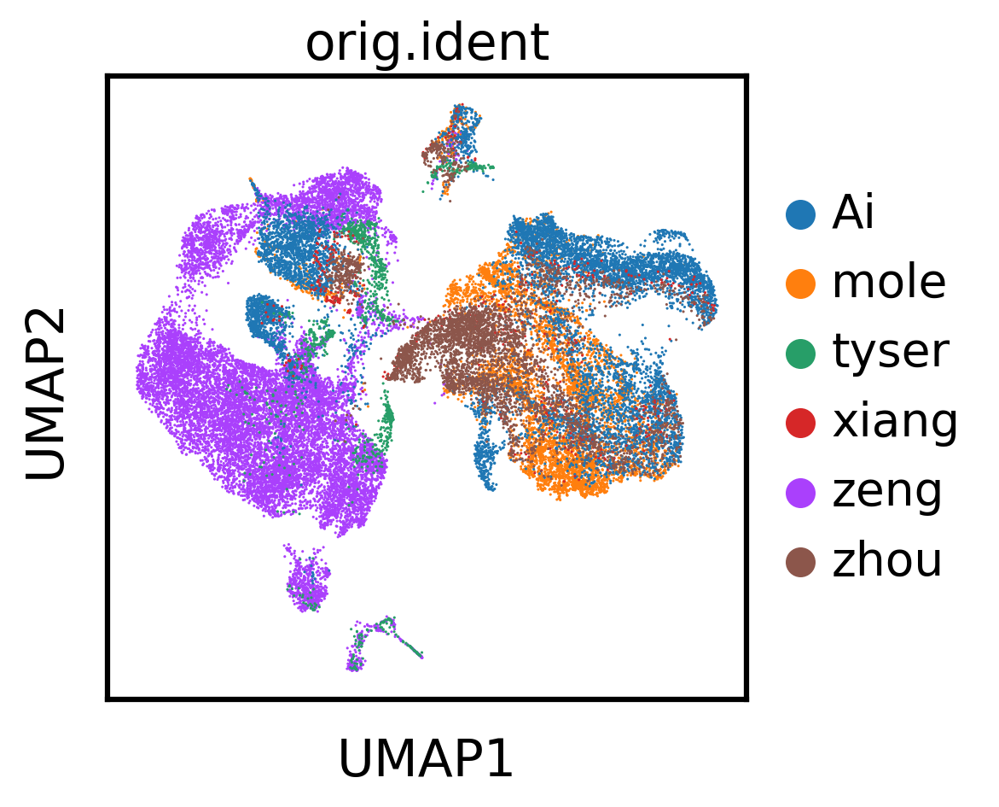

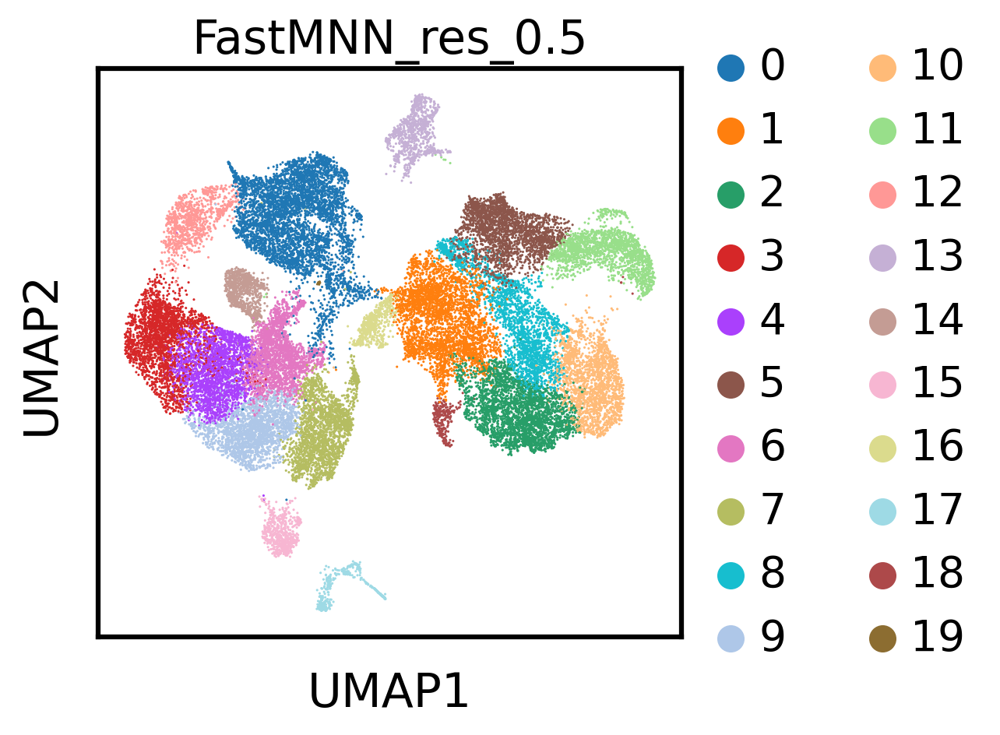

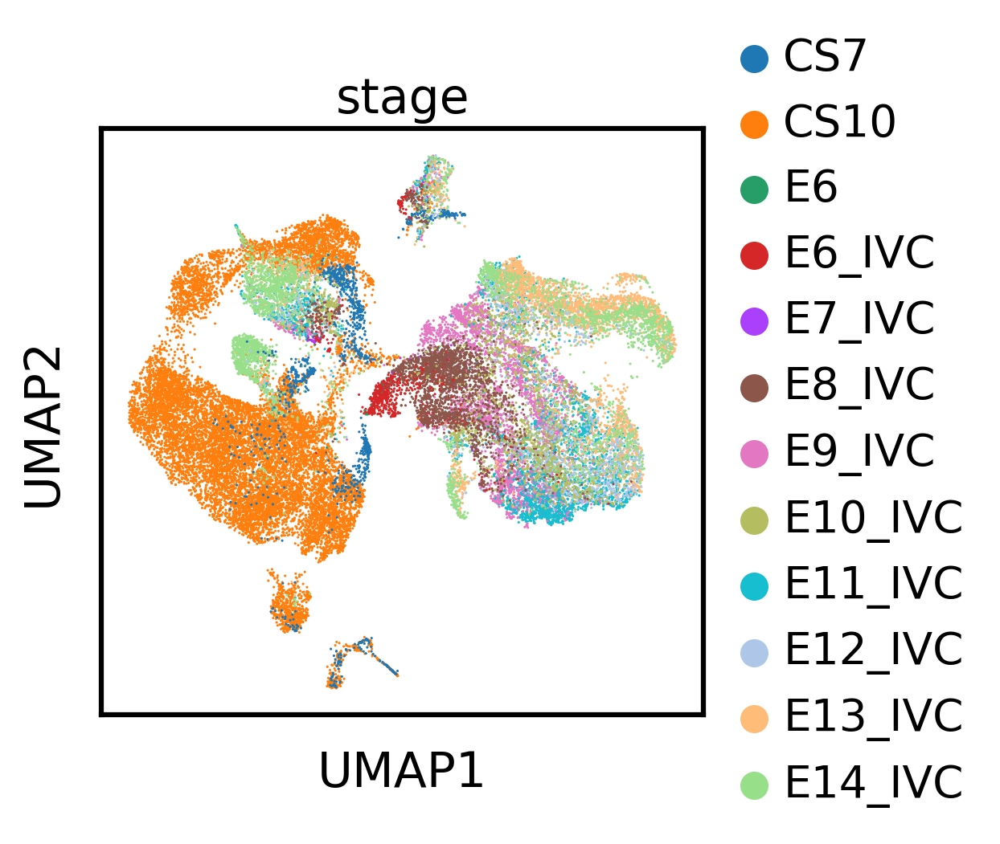

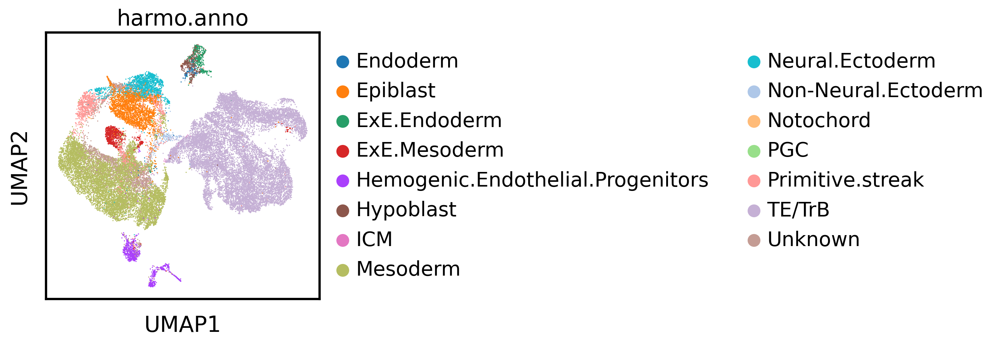

In [58]:
sc.pp.neighbors(adata, use_rep="FastMNN",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"FastMNN_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_FastMNN'] = adata.obsm['X_umap']
adata_hvg.obsm['X_FastMNN'] = adata.obsm['X_FastMNN']
sc.pl.umap(adata, color=['orig.ident'],save="FastMNN_orig.ident.pdf")
sc.pl.umap(adata, color=['FastMNN_res_0.5'],save="FastMNN_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="FastMNN_stage.pdf")
sc.pl.umap(adata, color=['harmo.anno'],save="FastMNN_harmo.anno.pdf")

In [59]:
adata

AnnData object with n_obs × n_vars = 34387 × 60421
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'anno', 'sub_anno', 'harmo.anno', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'umap', 'orig.ident_colors', 'Unintegrated_res_0.5_colors', 'stage_colors', 'harmo.anno_colors', 'Scanorama_res_0.5_colors', 'LIGER_res_0.5_colors', 'Harmony_res_0.5_colors', 'scVI_res_0.5_colors', 'scANVI_res_0.5_colors', 'CCA_res_0.5_colors', 'FastMNN_res_0.5_colors'
    obsm: 'X_pca', 'Unintegrated', 'X_umap', 'X_Unintegrated', 'Scanorama', 'X_Scanorama', 'LIGER', 'X_LIGER', 'Harmony', 'X_Harmony', 'scVI'

In [60]:
print(adata.layers["counts"])

(0, 4)        1.0
  (0, 10)       1.0
  (0, 12)       2.0
  (0, 20)       9.0
  (0, 22)       1.0
  (0, 25)       5.0
  (0, 26)       9.0
  (0, 28)       2.0
  (0, 31)       4.0
  (0, 39)       9.0
  (0, 40)       2.0
  (0, 43)       14.0
  (0, 46)       2.0
  (0, 47)       6.0
  (0, 48)       6.0
  (0, 53)       1.0
  (0, 54)       55.0
  (0, 55)       3.0
  (0, 56)       2.0
  (0, 57)       34.0
  (0, 63)       8.0
  (0, 65)       9.0
  (0, 66)       4.0
  (0, 68)       34.0
  (0, 75)       5.0
  :     :
  (34386, 54555)        2.0
  (34386, 54602)        2.0
  (34386, 54741)        3.0
  (34386, 54995)        1.0
  (34386, 55690)        1.0
  (34386, 55793)        1.0
  (34386, 55885)        1.0
  (34386, 56090)        39.0
  (34386, 56246)        1.0
  (34386, 56289)        1.0
  (34386, 56587)        1.0
  (34386, 56664)        2.0
  (34386, 56864)        1.0
  (34386, 56957)        1.0
  (34386, 57063)        4.0
  (34386, 57510)        2.0
  (34386, 57591)        1.0
  (34386, 57708)        3.0
  (34386, 57788)        1.0
  (34386, 57953)        1.0
  (34386, 57958)        1.0
  (34386, 58802)        1.0
  (34386, 58833)        1.0
  (34386, 60398)        49.0
  (34386, 60400)        104.0

In [61]:
####Perform the benchmark
bm = Benchmarker(
    adata,
    batch_key="orig.ident",
    label_key="harmo.anno",
    embedding_obsm_keys=["Unintegrated", "Scanorama", "LIGER", "Harmony", "scVI", "scANVI","CCA","FastMNN"],
    n_jobs=6,
)
bm.benchmark()

Metrics:  60%|█████████████████████████████████████████▍                           | 6/10 [00:35<00:16,  4.06s/it, Batch correction: kbet_per_label]

INFO     ICM consists of a single batch or is too small. Skip.                                                     
INFO     Neural.Ectoderm consists of a single batch or is too small. Skip.                                         
INFO     Notochord consists of a single batch or is too small. Skip.                                               
INFO     PGC consists of a single batch or is too small. Skip.                                                     



Metrics:   0%|                                                                                                               | 0/10 [00:00<?, ?it/s]
                                                                                                                                                    
Metrics:  60%|█████████████████████████████████████████▍                           | 6/10 [06:45<02:06, 31.68s/it, Batch correction: kbet_per_label]

INFO     ICM consists of a single batch or is too small. Skip.                                                     
INFO     Neural.Ectoderm consists of a single batch or is too small. Skip.                                         
INFO     Notochord consists of a single batch or is too small. Skip.                                               
INFO     PGC consists of a single batch or is too small. Skip.                                                     



Metrics:   0%|                                                                                                               | 0/10 [00:00<?, ?it/s]
                                                                                                                                                    
Metrics:  60%|█████████████████████████████████████████▍                           | 6/10 [00:33<00:11,  2.89s/it, Batch correction: kbet_per_label]

INFO     ICM consists of a single batch or is too small. Skip.                                                     
INFO     Neural.Ectoderm consists of a single batch or is too small. Skip.                                         
INFO     Notochord consists of a single batch or is too small. Skip.                                               
INFO     PGC consists of a single batch or is too small. Skip.                                                     



Metrics:   0%|                                                                                                               | 0/10 [00:00<?, ?it/s]
                                                                                                                                                    
Metrics:  60%|█████████████████████████████████████████▍                           | 6/10 [00:35<00:11,  2.93s/it, Batch correction: kbet_per_label]

INFO     ICM consists of a single batch or is too small. Skip.                                                     
INFO     Neural.Ectoderm consists of a single batch or is too small. Skip.                                         
INFO     Notochord consists of a single batch or is too small. Skip.                                               
INFO     PGC consists of a single batch or is too small. Skip.                                                     



Metrics:   0%|                                                                                                               | 0/10 [00:00<?, ?it/s]
                                                                                                                                                    
Metrics:  60%|█████████████████████████████████████████▍                           | 6/10 [00:30<00:10,  2.60s/it, Batch correction: kbet_per_label]

INFO     ICM consists of a single batch or is too small. Skip.                                                     
INFO     Neural.Ectoderm consists of a single batch or is too small. Skip.                                         
INFO     Notochord consists of a single batch or is too small. Skip.                                               
INFO     PGC consists of a single batch or is too small. Skip.                                                     



Metrics:   0%|                                                                                                               | 0/10 [00:00<?, ?it/s]
                                                                                                                                                    
Metrics:  60%|█████████████████████████████████████████▍                           | 6/10 [00:30<00:10,  2.58s/it, Batch correction: kbet_per_label]

INFO     ICM consists of a single batch or is too small. Skip.                                                     
INFO     Neural.Ectoderm consists of a single batch or is too small. Skip.                                         
INFO     Notochord consists of a single batch or is too small. Skip.                                               
INFO     PGC consists of a single batch or is too small. Skip.                                                     



Metrics:   0%|                                                                                                               | 0/10 [00:00<?, ?it/s]
                                                                                                                                                    
Metrics:  60%|█████████████████████████████████████████▍                           | 6/10 [03:44<01:10, 17.66s/it, Batch correction: kbet_per_label]

INFO     ICM consists of a single batch or is too small. Skip.                                                     
INFO     Neural.Ectoderm consists of a single batch or is too small. Skip.                                         
INFO     Notochord consists of a single batch or is too small. Skip.                                               
INFO     PGC consists of a single batch or is too small. Skip.                                                     



Metrics:   0%|                                                                                                               | 0/10 [00:00<?, ?it/s]
                                                                                                                                                    
Metrics:  60%|█████████████████████████████████████████▍                           | 6/10 [03:29<01:05, 16.44s/it, Batch correction: kbet_per_label]

INFO     ICM consists of a single batch or is too small. Skip.                                                     
INFO     Neural.Ectoderm consists of a single batch or is too small. Skip.                                         
INFO     Notochord consists of a single batch or is too small. Skip.                                               
INFO     PGC consists of a single batch or is too small. Skip.                                                     



Embeddings: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [19:50<00:00, 148.86s/it]

                                                                                                                                                    

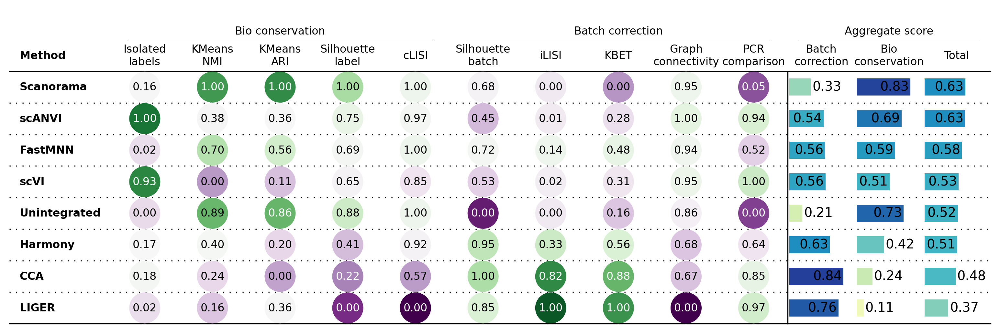

In [62]:
bm.plot_results_table(save_dir="/mnt/disk5/Lanxiang/Human_integrated/integrated/8_Progress/human_ref_all/figures/")

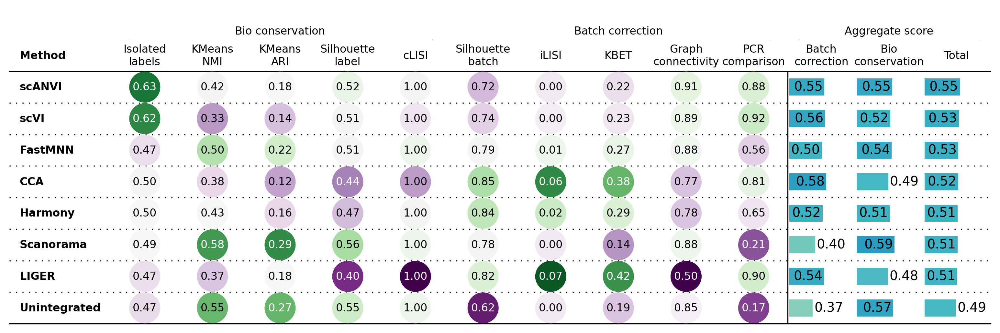

In [63]:
bm.plot_results_table(min_max_scale=False,save_dir="/mnt/disk5/Lanxiang/Human_integrated/integrated/8_Progress/human_ref_all/figures/")

In [64]:
adata.raw.var.rename(columns={'_index': 'index'}, inplace=True)
adata.write_h5ad(filename="scib_human_all8.20.h5ad")

In [65]:
from rich import print

df = bm.get_results(min_max_scale=False)
print(df)

Isolated labels        KMeans NMI        KMeans ARI  \
Embedding                                                            
Unintegrated          0.467746          0.550644          0.266488   
Scanorama             0.493122          0.577716          0.289868   
LIGER                 0.470311          0.365412          0.183291   
Harmony               0.495696          0.427137          0.157088   
scVI                  0.618265          0.325148          0.141758   
scANVI                0.629869          0.421956          0.183911   
CCA                   0.497415          0.384856          0.123876   
FastMNN               0.470758          0.500711          0.217099   
Metric Type   Bio conservation  Bio conservation  Bio conservation   

              Silhouette label             cLISI  Silhouette batch  \
Embedding                                                            
Unintegrated          0.545601               1.0           0.61538   
Scanorama             0.564832               1.0           0.77859   
LIGER                 0.400515           0.99565          0.818947   
Harmony               0.468676          0.999647          0.842523   
scVI                  0.507711          0.999365          0.742436   
scANVI                0.523659          0.999881          0.723437   
CCA                    0.43733           0.99811          0.854938   
FastMNN               0.514522               1.0          0.788351   
Metric Type   Bio conservation  Bio conservation  Batch correction   

                         iLISI              KBET Graph connectivity  \
Embedding                                                             
Unintegrated               0.0          0.188064           0.850589   
Scanorama                  0.0          0.143182             0.8848   
LIGER                  0.07222          0.415219           0.500245   
Harmony               0.024111          0.294177           0.777426   
scVI                  0.001705          0.228388           0.888129   
scANVI                0.000435          0.218103           0.906682   
CCA                   0.058963          0.383448           0.773482   
FastMNN               0.010276           0.27242           0.880936   
Metric Type   Batch correction  Batch correction   Batch correction   

                PCR comparison Batch correction Bio conservation  \
Embedding                                                          
Unintegrated           0.17217         0.365241         0.566096   
Scanorama             0.206881         0.402691         0.585108   
LIGER                 0.902029         0.541732         0.483036   
Harmony               0.649517         0.517551         0.509649   
scVI                   0.92198         0.556528         0.518449   
scANVI                0.879141          0.54556         0.551855   
CCA                   0.806105         0.575387         0.488317   
FastMNN               0.563478         0.503092         0.540618   
Metric Type   Batch correction  Aggregate score  Aggregate score   

                        Total  
Embedding                      
Unintegrated         0.485754  
Scanorama            0.512141  
LIGER                0.506514  
Harmony               0.51281  
scVI                 0.533681  
scANVI               0.549337  
CCA                  0.523145  
FastMNN              0.525608  
Metric Type   Aggregate score

In [66]:
df.to_csv('scib_df.csv')

In [67]:
df.transpose()

Embedding,Unintegrated,Scanorama,LIGER,Harmony,scVI,scANVI,CCA,FastMNN,Metric Type
Isolated labels,0.467746,0.493122,0.470311,0.495696,0.618265,0.629869,0.497415,0.470758,Bio conservation
KMeans NMI,0.550644,0.577716,0.365412,0.427137,0.325148,0.421956,0.384856,0.500711,Bio conservation
KMeans ARI,0.266488,0.289868,0.183291,0.157088,0.141758,0.183911,0.123876,0.217099,Bio conservation
Silhouette label,0.545601,0.564832,0.400515,0.468676,0.507711,0.523659,0.43733,0.514522,Bio conservation
cLISI,1.0,1.0,0.99565,0.999647,0.999365,0.999881,0.99811,1.0,Bio conservation
Silhouette batch,0.61538,0.77859,0.818947,0.842523,0.742436,0.723437,0.854938,0.788351,Batch correction
iLISI,0.0,0.0,0.07222,0.024111,0.001705,0.000435,0.058963,0.010276,Batch correction
KBET,0.188064,0.143182,0.415219,0.294177,0.228388,0.218103,0.383448,0.27242,Batch correction
Graph connectivity,0.850589,0.8848,0.500245,0.777426,0.888129,0.906682,0.773482,0.880936,Batch correction
PCR comparison,0.17217,0.206881,0.902029,0.649517,0.92198,0.879141,0.806105,0.563478,Batch correction


In [68]:
df_transposed = df.transpose()
df_transposed.to_csv('scib_df_transposed.csv', index=False)

In [69]:
from rich import print

df2 = bm.get_results()
print(df2)

Isolated labels        KMeans NMI        KMeans ARI  \
Embedding                                                            
Unintegrated               0.0          0.892812          0.859148   
Scanorama             0.156527               1.0               1.0   
LIGER                  0.01582          0.159417          0.357939   
Harmony               0.172399          0.403808          0.200081   
scVI                  0.928428               0.0          0.107729   
scANVI                     1.0          0.383292          0.361673   
CCA                   0.183001          0.236401               0.0   
FastMNN               0.018577          0.695111          0.561609   
Metric Type   Bio conservation  Bio conservation  Bio conservation   

              Silhouette label             cLISI  Silhouette batch  \
Embedding                                                            
Unintegrated          0.882963               1.0               0.0   
Scanorama                  1.0               1.0          0.681297   
LIGER                      0.0               0.0          0.849762   
Harmony               0.414817          0.918786          0.948176   
scVI                  0.652373          0.853997          0.530377   
scANVI                0.749432          0.972561          0.451071   
CCA                   0.224053          0.565503               1.0   
FastMNN               0.693825          0.999998          0.722043   
Metric Type   Bio conservation  Bio conservation  Batch correction   

                         iLISI              KBET Graph connectivity  \
Embedding                                                             
Unintegrated               0.0          0.164985           0.861988   
Scanorama             0.000002               0.0           0.946161   
LIGER                      1.0               1.0                0.0   
Harmony               0.333847          0.555053           0.681978   
scVI                  0.023611          0.313215           0.954352   
scANVI                0.006019          0.275407                1.0   
CCA                    0.81643          0.883211           0.672275   
FastMNN               0.142282          0.475075           0.936655   
Metric Type   Batch correction  Batch correction   Batch correction   

                PCR comparison Batch correction Bio conservation  \
Embedding                                                          
Unintegrated               0.0         0.205395         0.726985   
Scanorama             0.046293         0.334751         0.831305   
LIGER                 0.973392         0.764631         0.106635   
Harmony               0.636624         0.631136         0.421978   
scVI                       1.0         0.564311         0.508505   
scANVI                0.942867         0.535073         0.693392   
CCA                   0.845461         0.843476         0.241791   
FastMNN               0.521876         0.559586         0.593824   
Metric Type   Batch correction  Aggregate score  Aggregate score   

                        Total  
Embedding                      
Unintegrated         0.518349  
Scanorama            0.632683  
LIGER                0.369833  
Harmony              0.505641  
scVI                 0.530828  
scANVI               0.630064  
CCA                  0.482465  
FastMNN              0.580129  
Metric Type   Aggregate score